# Self-Driving Car Engineer Nanodegree


## Project: **Advanced Lane Lines** 

**Run the cell below to import some packages.  If you get an `import error` for a package you've already installed, try changing your kernel (select the Kernel menu above --> Change Kernel).  Still have problems?  Try relaunching Jupyter Notebook from the terminal prompt.  Also, see [this forum post](https://carnd-forums.udacity.com/cq/viewquestion.action?spaceKey=CAR&id=29496372&questionTitle=finding-lanes---import-cv2-fails-even-though-python-in-the-terminal-window-has-no-problem-with-import-cv2) for more troubleshooting tips.**  

## Step 1 - Camera Calibration

In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import glob
import pickle
from moviepy.editor import VideoFileClip

%matplotlib inline

print('Imports done.')

# Line class to store the characteristics of each detected lane line
class Line():
    def reset(self):
        self.N_FITS = 5 # number of fits to combine for smoothing 
        self.detected = False # valid lane detection flag
        self.valid_reason = '' # reason for valid lane judgement
        self.current_x = [[]] # x coordinates of detected lane points in current frame
        self.current_y = [[]] # y coordinates of detected lane points in current frame
        self.all_x = [[]] # x coordinates of detected lane points in combined frames
        self.all_y = [[]] # y coordinates of detected lane points in combined frames
        self.current_fit = np.array([0, 0, 0]) # 2nd order polyfit coefficients for current x,y points
        self.all_fit = np.array([0, 0, 0]) # 2nd order polyfit coefficients for combined x,y points
        self.radius_of_curvature = 0.0 # calculated radius of curvature of line
        self.line_base_pos = 0.0 # calculated offset distance from line to center of car
        
    def __init__(self):
        self.reset()
        
def reset_lanes():
    left_lane.reset()
    right_lane.reset()

    
# Define conversions in x and y from pixels space to meters based on US standards
US_LANE_WIDTH = 3.7 # m wide lane
US_LANE_LINE_LENGTH = 3.0 # m long lines
LANE_WIDTH_PIX = 675 # (980-305) pixels
LANE_LINE_LENGTH_PIX = 83 # (533-450) pixels

ym_per_pix = US_LANE_LINE_LENGTH/LANE_LINE_LENGTH_PIX # meters per pixel in y dimension = 0.036145
xm_per_pix = US_LANE_WIDTH/LANE_WIDTH_PIX # meters per pixel in x dimension = 0.005481

left_lane = Line()
right_lane = Line()
print('Lane line objects created.')

Imports done.
Lane line objects created.


Processing camera calibration images...


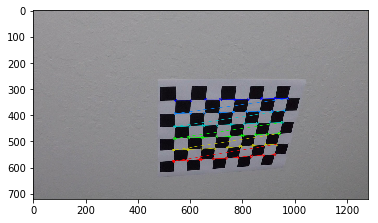

Image size = (1280, 720)



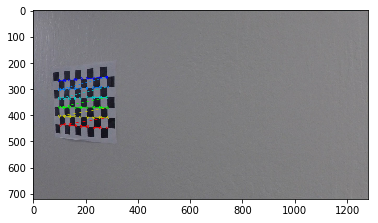

Image size = (1280, 720)



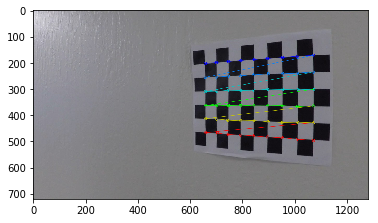

Image size = (1280, 720)



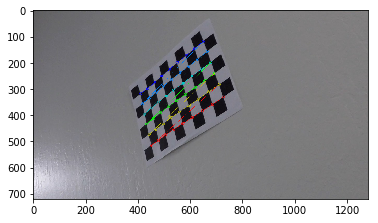

Image size = (1280, 720)



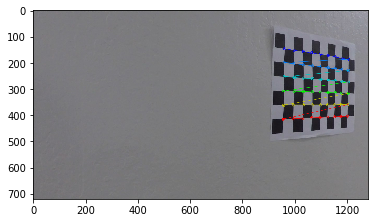

Image size = (1280, 720)



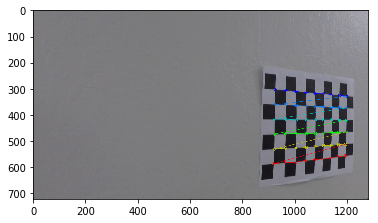

Image size = (1281, 721)



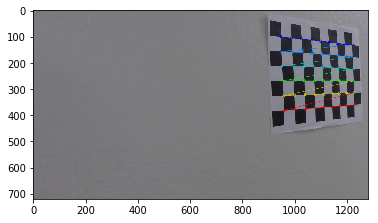

Image size = (1280, 720)



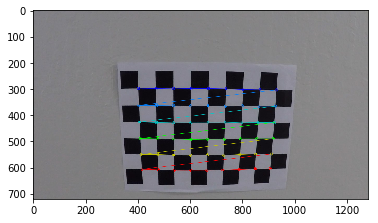

Image size = (1280, 720)



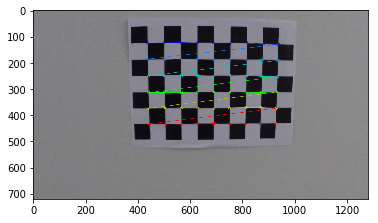

Image size = (1280, 720)



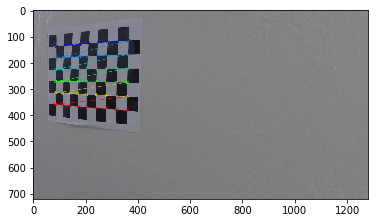

Image size = (1280, 720)



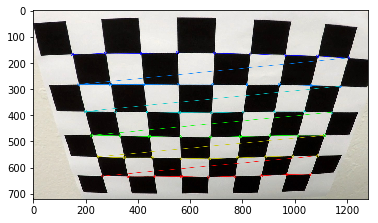

Image size = (1280, 720)



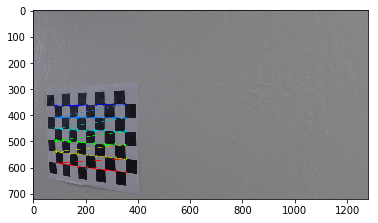

Image size = (1280, 720)



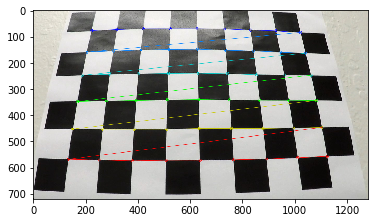

Image size = (1280, 720)



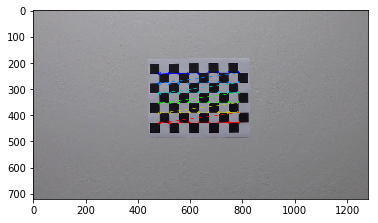

Image size = (1280, 720)



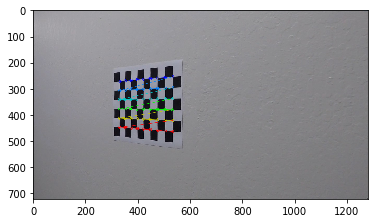

Image size = (1281, 721)



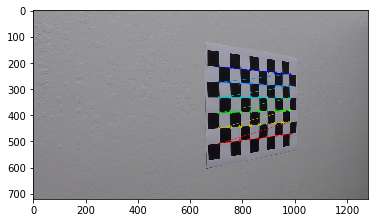

Image size = (1280, 720)



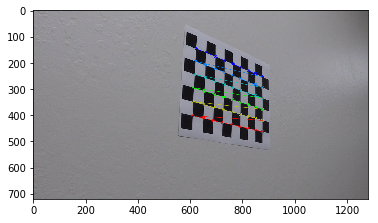

Image size = (1280, 720)

Distortion coefficients [k1, k2, p1, p2, k3]:
[[ -2.41017956e-01  -5.30721173e-02  -1.15810355e-03  -1.28318856e-04
    2.67125290e-02]]

Calibration dist/mtx pickle saved as "camera_cal/camera_mtx_dist_pickle.p".
Done.


In [2]:
""" Camera calibration"""

def recal_camera(cal_images):
    """
    Load chessboard calibration images, process with cv2.findChessboardCorners() to detect the
    corner points, generate camera calibration coeffiencts with cv2.calibrateCamera(), and
    store the results in a pickle file.
    """
    
    # Number of chessboard internal corners in calibration images
    NX = 9
    NY = 6

    print('Processing camera calibration images...')
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(9,6,0)
    objp = np.zeros((NX*NY,3), np.float32)
    objp[:,:2] = np.mgrid[0:NX, 0:NY].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Make a list of calibration images
    images = glob.glob(cal_images)

    # Step through the list and search for chessboard corners
    for idx, fname in enumerate(images):
        img = mpimg.imread(fname)
        img_size = (img.shape[1], img.shape[0])
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (NX,NY), None)

        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)

            # Draw and display the corners
            cv2.drawChessboardCorners(img, (NX, NY), corners, ret)
            plt.imshow(img)
            plt.show()
            print('Image size = {}\n'.format(img_size))

    # Do camera calibration given object points and image points
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
    print('Distortion coefficients [k1, k2, p1, p2, k3]:\n{}\n'.format(dist))

    # Save the camera calibration result in a pickle file
    dist_pickle = {}
    dist_pickle['mtx'] = mtx
    dist_pickle['dist'] = dist
    pickle.dump( dist_pickle, open('camera_cal/camera_mtx_dist_pickle.p', 'wb'))
    print('Calibration dist/mtx pickle saved as "camera_cal/camera_mtx_dist_pickle.p".')
    
    
recal_camera('camera_cal/calibration*.jpg')
print('Done.')

Loaded distortion coefficients [k1, k2, p1, p2, k3]:
[[ -2.41017956e-01  -5.30721173e-02  -1.15810355e-03  -1.28318856e-04
    2.67125290e-02]]

Undistorting image...



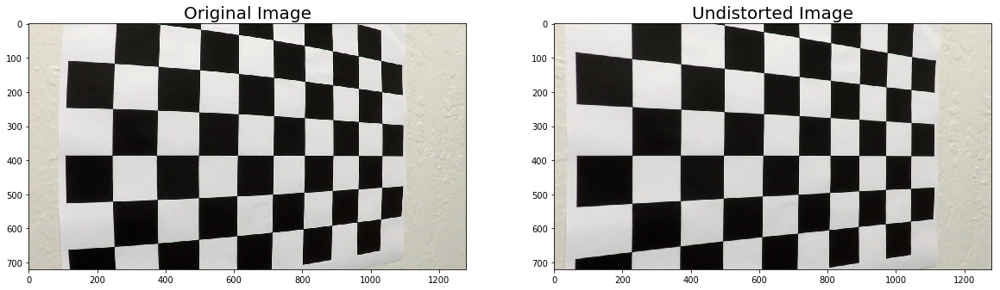

In [3]:
""" Test camera calibration by undistorting a chessboard image """

def camera_undistort(img, mtx, dist, debug=False):
    """
    Undistort image using camera calibration coefficients (mtx, dist)
    """
    img_out = cv2.undistort(img, mtx, dist, None, mtx)
    
    if debug == True:
        print('Undistorting image...\n')
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=20)
        ax2.imshow(img_out)
        ax2.set_title('Undistorted Image', fontsize=20)
        plt.show()
        
    return img_out


# Load camera calibration coefficients from pickle file
dist_pickle = pickle.load(open('camera_cal/camera_mtx_dist_pickle.p', 'rb'))
mtx = dist_pickle['mtx']
dist = dist_pickle['dist']
print('Loaded distortion coefficients [k1, k2, p1, p2, k3]:\n{}\n'.format(dist))

# Test undistortion
test_img = mpimg.imread('camera_cal/calibration5.jpg')
test_img_undist = camera_undistort(test_img, mtx, dist, debug=True)

## Pipeline Functions

Undistorting image...



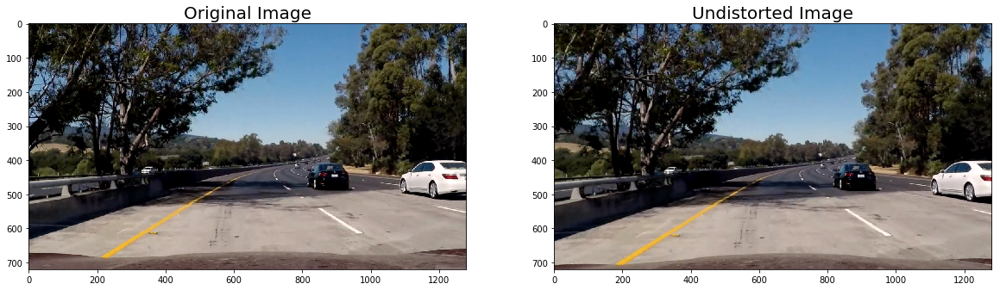

In [4]:
""" Pipeline Step 1: Undistort image with camera calibration coefficients """

test_image = 'test_images/test5.jpg'

reset_lanes()
img = mpimg.imread(test_image)

img_undist = camera_undistort(img, mtx, dist, debug=True)

Before CLAHE


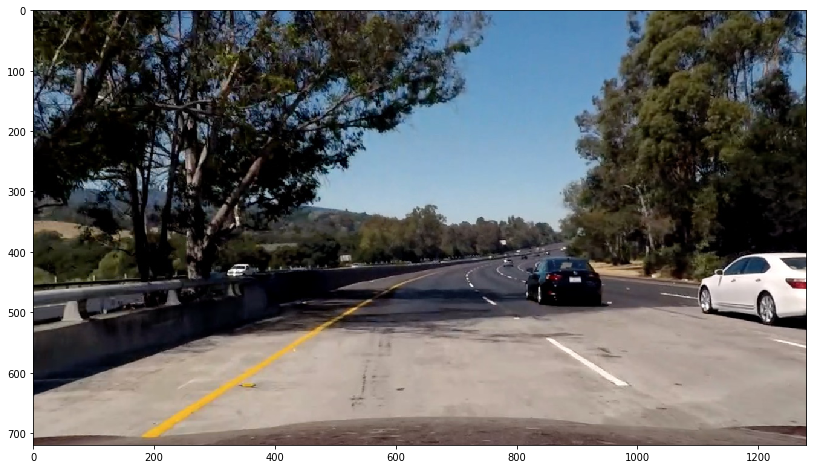

After CLAHE


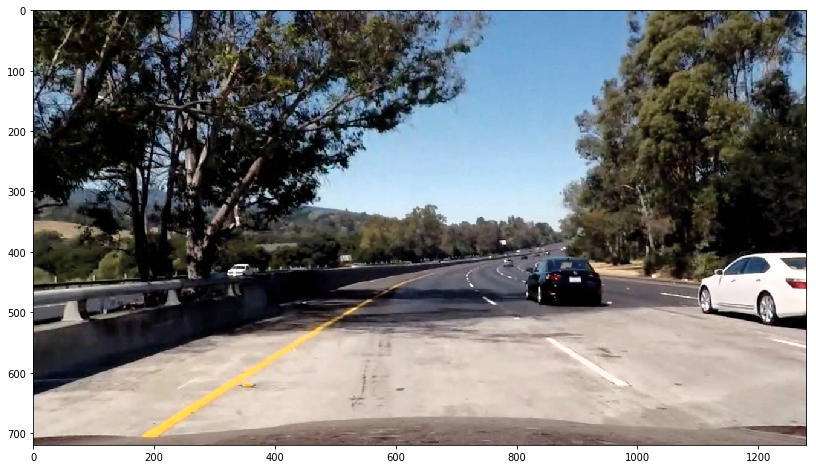

In [5]:
""" Pipeline Step 2: Adaptive histogram equalization for lightness of image """

def apply_CLAHE_LAB(img, debug=False):
    """
    Convert image from RGB->LAB and apply CLAHE contrast-limited adaptive histogram equalization
    to the lightness channel to help normalize the images for visual processing.
    
    This function returns the CLAHE normalized image.
    """
    image_wk = np.copy(img)
    image_wk = cv2.cvtColor(image_wk, cv2.COLOR_RGB2LAB)
    clahe = cv2.createCLAHE(clipLimit=1.0, tileGridSize=(1,1))
    image_wk[:,:,0] = clahe.apply(image_wk[:,:,0])
    image_wk = cv2.cvtColor(image_wk, cv2.COLOR_LAB2RGB)
    
    if debug == True:
        print('Before CLAHE')
        plt.figure(figsize = (15,8))
        plt.imshow(img)
        plt.show()
        
        print('After CLAHE')
        plt.figure(figsize = (15,8))
        plt.imshow(image_wk)
        plt.show()
        
    return image_wk


img_CLAHE = apply_CLAHE_LAB(img_undist, debug=True)

Before perspective transform (source trapezoid vertices)


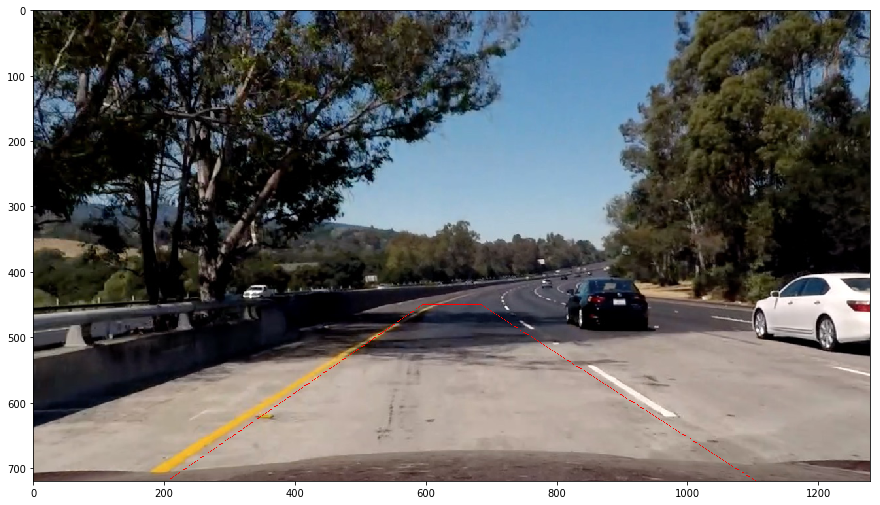

After perspective transform (destination rectangle vertices)


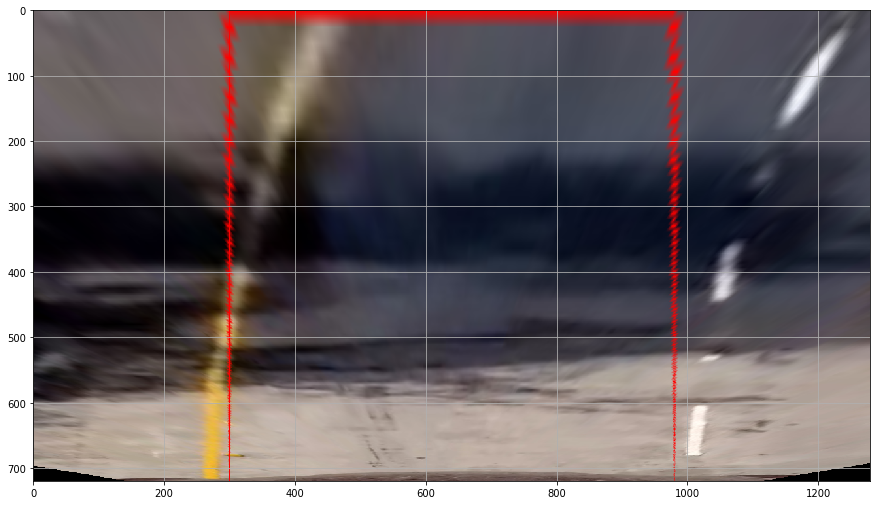

In [6]:
""" Pipeline Step 3: Perspective transform to bird's eye view """

def do_perspective_transform(img, M, debug=False):
    """
    Warp image using perspective transform matrix M and cv2.warpPerspective() with linear interpolation.
    
    This function returns the warped image.
    """
    img_warped = cv2.warpPerspective(img, M, (img.shape[1], img.shape[0]), flags=cv2.INTER_LINEAR)
    
    if debug == True:
        plt.figure(figsize = (15, 10))
        plt.imshow(img_warped, cmap='gray')
        plt.show()

    return img_warped

def set_perspective_transform(img, video=0, debug=False):
    """
    Set perspective transform matrices M & Minv using fixed source/destination points picked
    from a straight lane road image.
    
    This function returns the transformation matrices M and Minv.
    """
    img_PTin = np.copy(img)
    img_size = (img_PTin.shape[1], img_PTin.shape[0])
    y_car = img_PTin.shape[0]
        
    if video == 0:
        # Original perspective TRAPEZOID points for PROJECT VIDEO
        XL_CAR = 205
        XR_CAR = 1105
        XL_VANISH = 595
        XR_VANISH = 685
        Y_VANISH = 450
        
    elif video == 1:
        # Original perspective TRAPEZOID points for CHALLENGE VIDEO
        XL_CAR = 295
        XR_CAR = 1130
        XL_VANISH = 600
        XR_VANISH = 720
        Y_VANISH = 480
        
    elif video == 2:
       # Original perspective TRAPEZOID points for HARDER CHALLENGE VIDEO
        XL_CAR = 255
        XR_CAR = 1105
        XL_VANISH = 585
        XR_VANISH = 755
        Y_VANISH = 470
        
    # Transformed perspective RECTANGLE points
    XL_CAR_PT = 300
    XR_CAR_PT = 980
    Y_VANISH_PT = 0
 
    # TRAPEZOID vertices
    trap_bl = [XL_CAR, y_car]
    trap_tl = [XL_VANISH, Y_VANISH]
    trap_tr = [XR_VANISH, Y_VANISH]
    trap_br = [XR_CAR, y_car]
    trap_vertices = np.array([[trap_bl, trap_tl, trap_tr, trap_br]], dtype=np.int32)

    # RECTANGLE vertices
    rect_bl = [XL_CAR_PT, y_car]
    rect_tl = [XL_CAR_PT, Y_VANISH_PT]
    rect_tr = [XR_CAR_PT, Y_VANISH_PT]
    rect_br = [XR_CAR_PT, y_car]
    rect_vertices = np.array([[rect_bl, rect_tl, rect_tr, rect_br]], dtype=np.int32)

    # Source = TRAPEZOID, Destination = RECTANGLE
    src = np.float32([trap_bl, trap_tl, trap_tr, trap_br])
    dst = np.float32([rect_bl, rect_tl, rect_tr, rect_br])

    # Set perspective transform matrices
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    if debug == True:
        print('Before perspective transform (source trapezoid vertices)')
        cv2.polylines(img_PTin, trap_vertices, True, (255, 0, 0))
        plt.figure(figsize = (15, 10))
        plt.imshow(img_PTin)
        plt.show()
        
        print('After perspective transform (destination rectangle vertices)')
        img_warped = do_perspective_transform(img_PTin, M)
        image_wk = np.copy(img_warped)
        cv2.polylines(image_wk, rect_vertices, True, (255, 0, 0))
        plt.figure(figsize = (15, 10))
        plt.grid()
        plt.imshow(image_wk)
        plt.show()

    return M, Minv


VIDEO_SWITCH = 0
# 0 = Project video
# 1 = Challenge video
# 2 = Harder challenge video

M, Minv = set_perspective_transform(img_undist, video=VIDEO_SWITCH, debug=True)
img_warped = do_perspective_transform(img_undist, M)
plt.imsave('output_images/img_warped_for_lengths.jpg',img_warped)

LAB Color Space


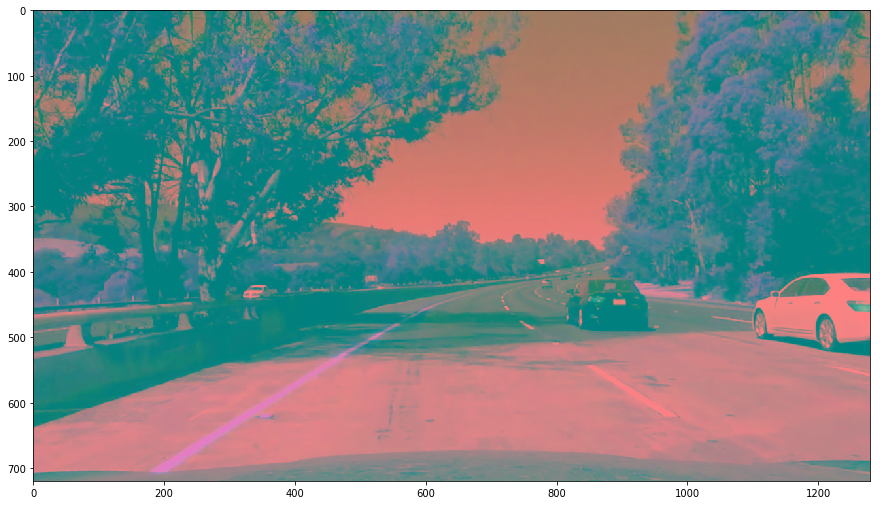

Yellow Binary


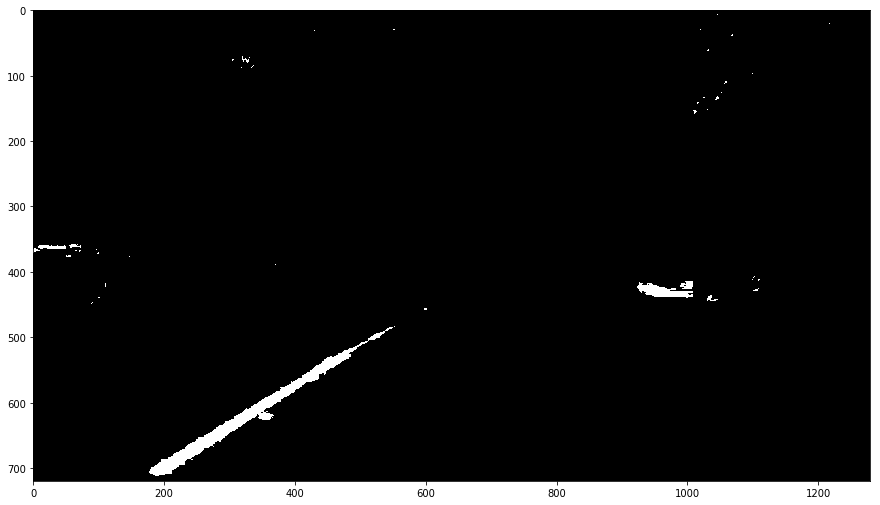

White Binary


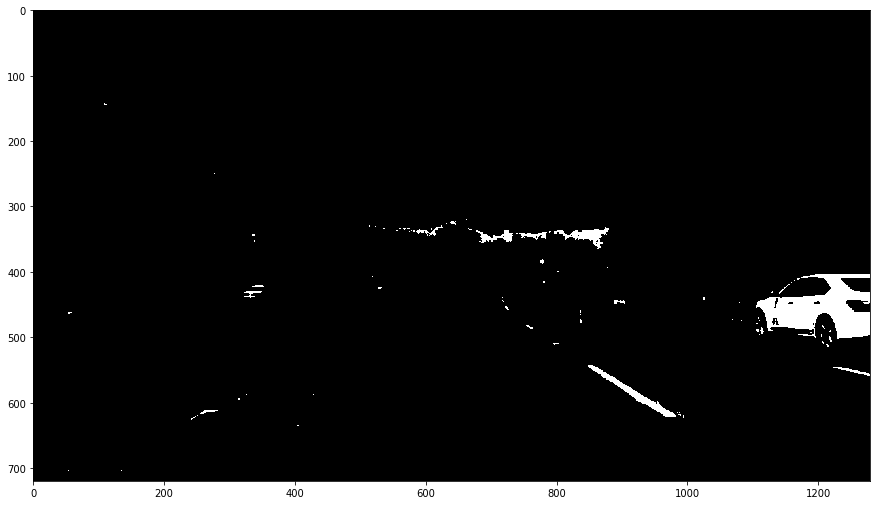

Yellow + White Binary


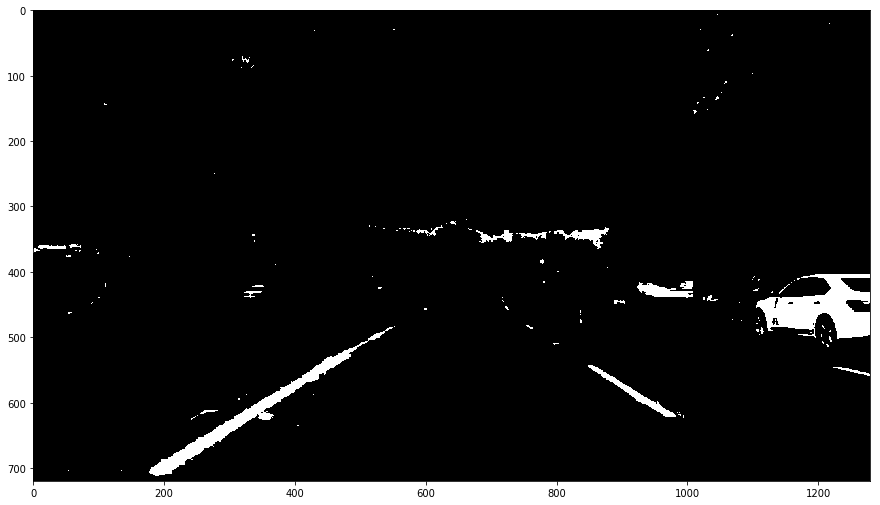

Blur Yellow + White Binary


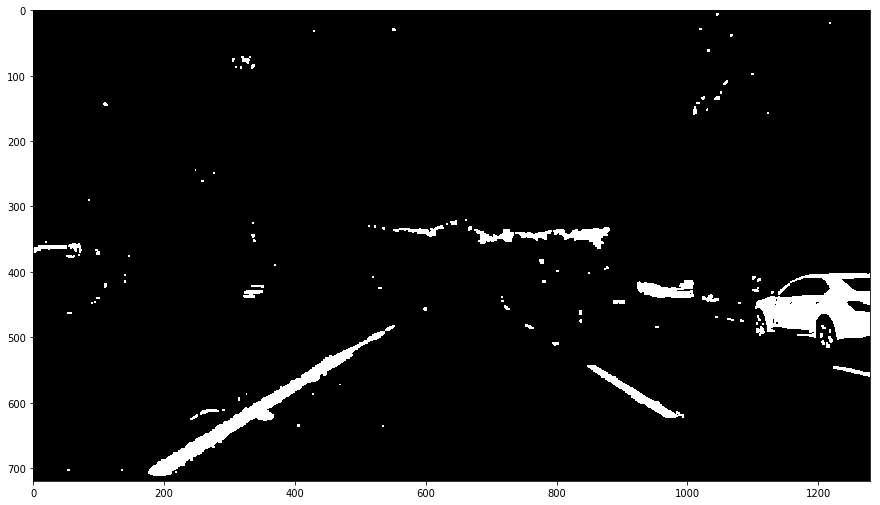

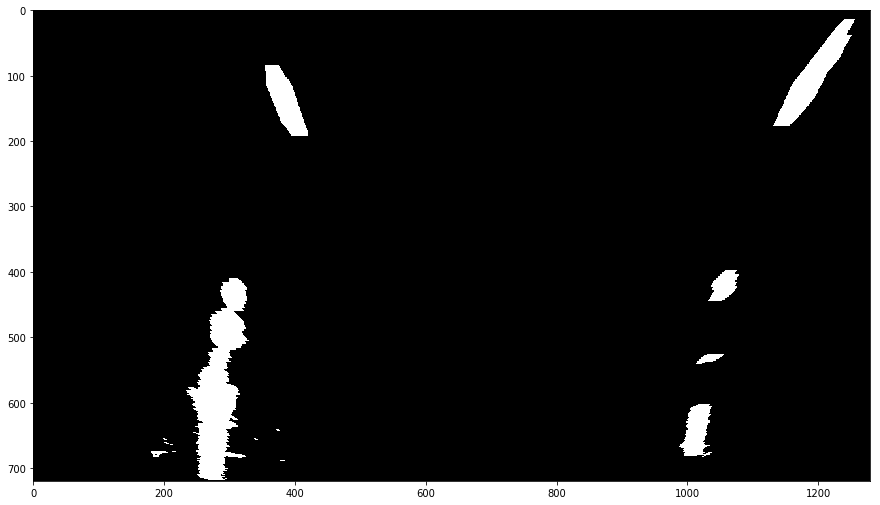

In [7]:
""" Pipeline Step 4: Color threshold binary image """

def color_binary_thresh(img, debug=False):
    """
    Convert image to LAB color space and make binary images for yellow and white color detection.
    Combine yellow and white binary images and blur to expand detected region for masking with
    gradient binary image.
    
    This function returns the binary image of blurred Yellow+White color filter.
    """
    img_CBTin = np.copy(img)
    
    def color_select(img, val, thresh=(0, 255)):
        channel = img[:,:,val]
        binary_output = np.zeros_like(channel)
        binary_output[(channel > thresh[0]) & (channel <= thresh[1])] = 1
        return binary_output

    img_LAB = cv2.cvtColor(img_CBTin, cv2.COLOR_RGB2LAB)
    
    # Make YELLOW binary image
    binary_yellow_L = color_select(img_LAB, 0, thresh=(130, 255))
    binary_yellow_A = color_select(img_LAB, 1, thresh=(100, 150))
    binary_yellow_B = color_select(img_LAB, 2, thresh=(145, 210))
    
    binary_yellow = np.zeros_like(binary_yellow_L)
    binary_yellow[(binary_yellow_L == 1) & (binary_yellow_A == 1) & (binary_yellow_B == 1)] = 1
    
    # Make WHITE binary image
    binary_white_L = color_select(img_LAB, 0, thresh=(230, 255))
    binary_white_A = color_select(img_LAB, 1, thresh=(120, 140))
    binary_white_B = color_select(img_LAB, 2, thresh=(120, 140))
    
    binary_white = np.zeros_like(binary_white_L)
    binary_white[(binary_white_L == 1) & (binary_white_A == 1) & (binary_white_B == 1)] = 1
    
    # Combine YELLOW and WHITE binary images
    binary_color = np.zeros_like(binary_yellow)
    binary_color[(binary_yellow == 1) | (binary_white == 1)] = 1
    
    # Blur binary image to expand for masking
    binary_color_float = binary_color.astype(np.float)
    binary_color_float = cv2.blur(binary_color_float, (3, 3))
    binary_color_blur = np.zeros_like(binary_color)
    binary_color_blur[ (binary_color_float > 0.0) ] = 1
    
    if debug == True:
        print('LAB Color Space')
        plt.figure(figsize = (15, 10))
        plt.imshow(img_LAB)
        plt.show()
        
        print('Yellow Binary')
        plt.figure(figsize = (15, 10))
        plt.imshow(binary_yellow, cmap='gray')
        plt.show()
        
        print('White Binary')
        plt.figure(figsize = (15, 10))
        plt.imshow(binary_white, cmap='gray')
        plt.show()
        
        print('Yellow + White Binary')
        plt.figure(figsize = (15, 10))
        plt.imshow(binary_color, cmap='gray')
        plt.show()
        
        print('Blur Yellow + White Binary')
        plt.figure(figsize = (15, 10))
        plt.imshow(binary_color_blur, cmap='gray')
        plt.show()

    return binary_color_blur


binary_color = color_binary_thresh(img_CLAHE, debug=True)
binary_color_warped = do_perspective_transform(binary_color, M, debug=True)

Gradient along X-axis


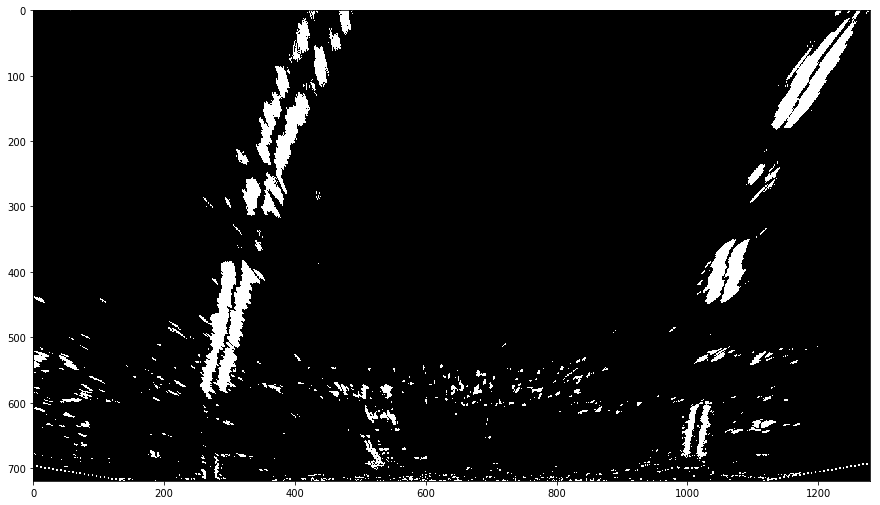

Denoise


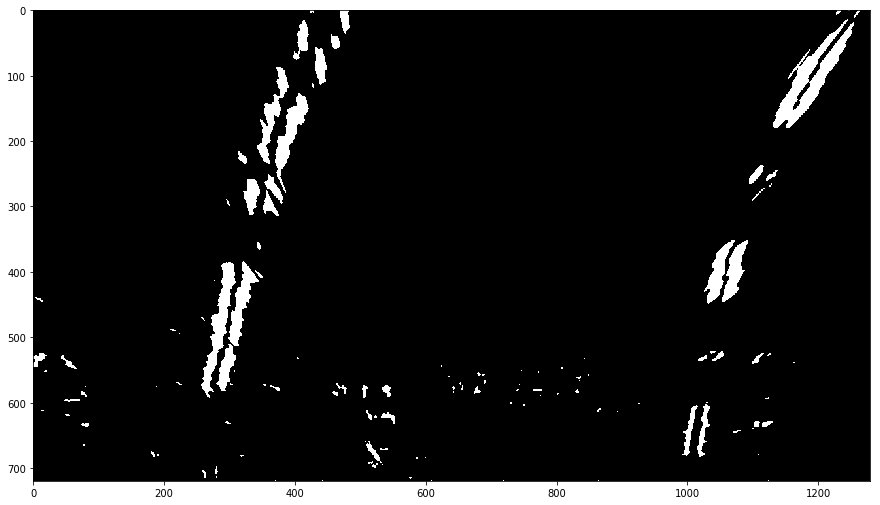

Gradient by Magnitude


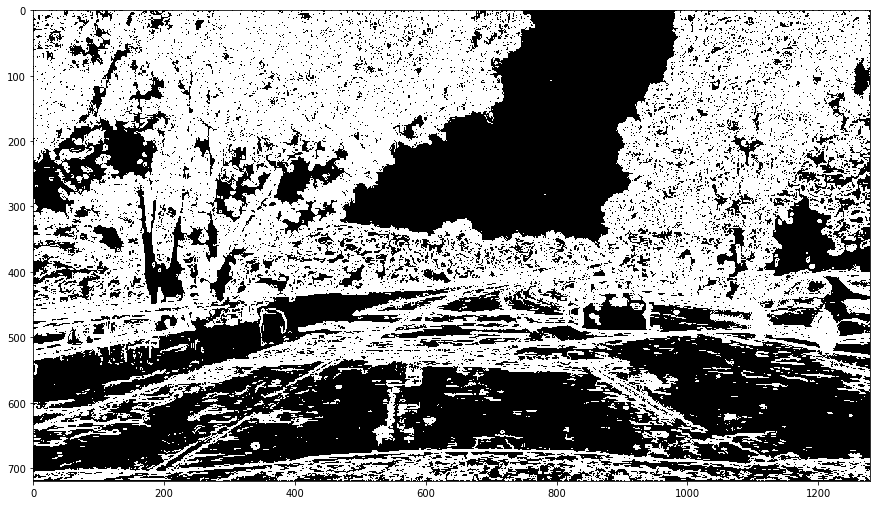

Gradient by Direction


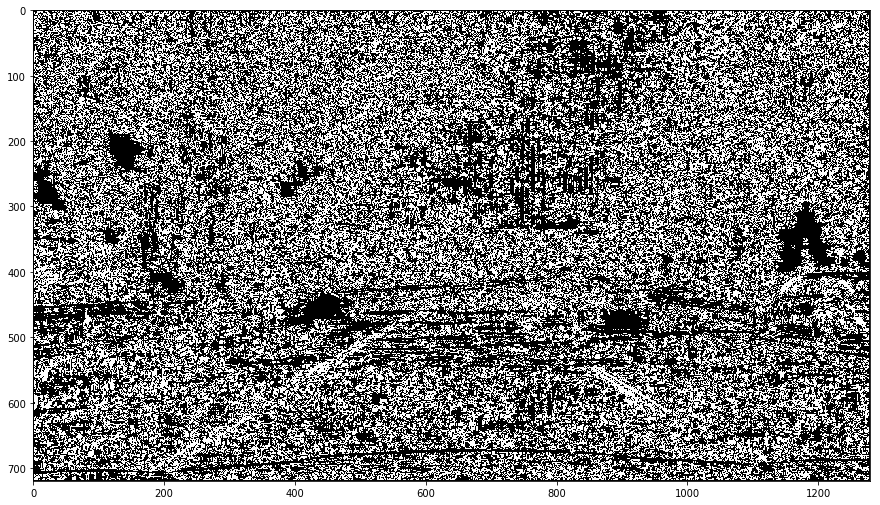

Gradient by Combined Magnitude + Direction


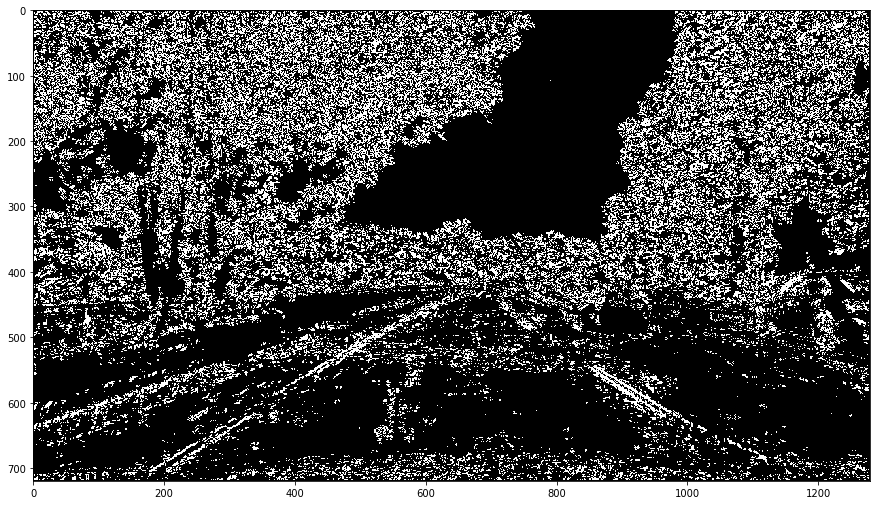

Denoise


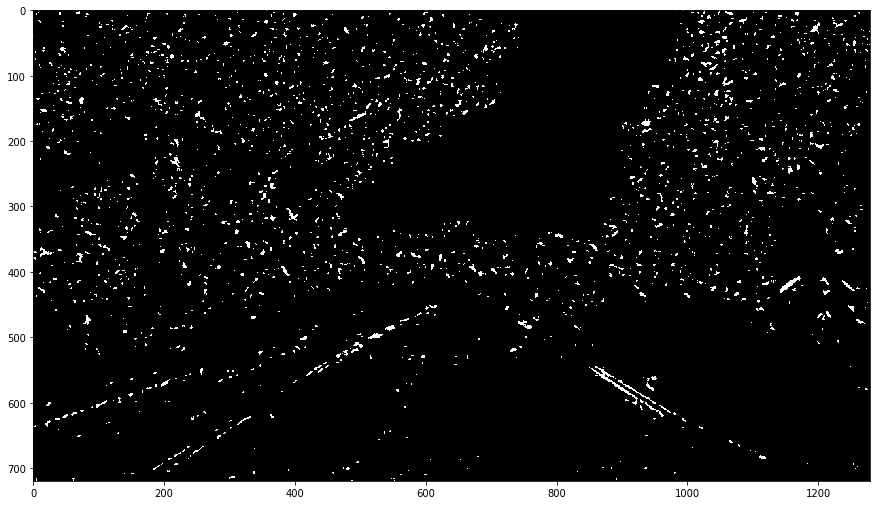

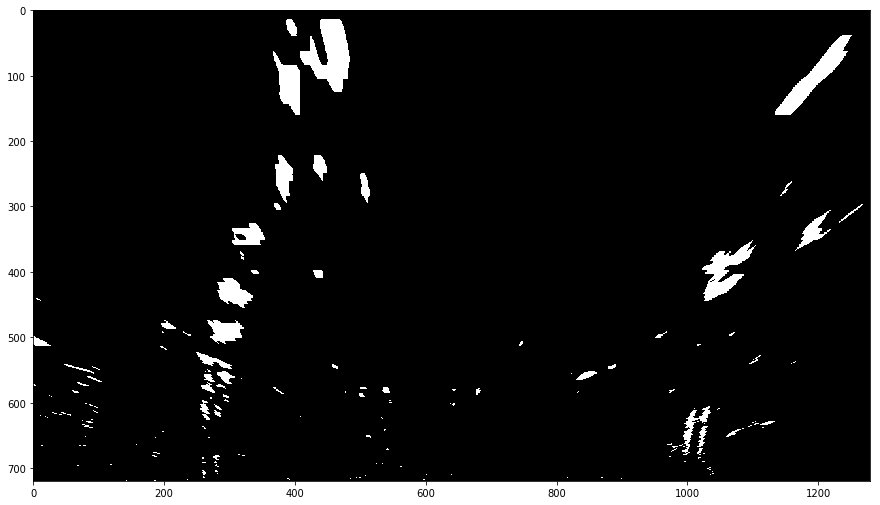

Combined Gradient Binary


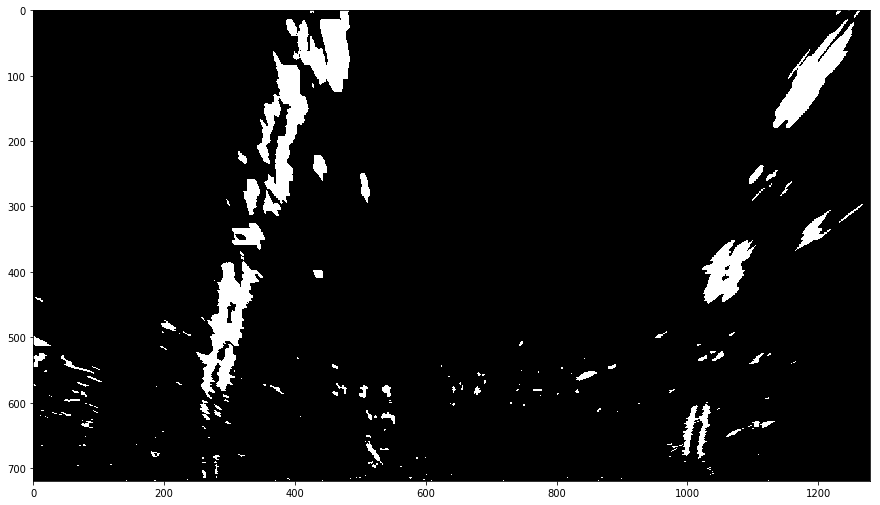

In [8]:
""" Pipeline Step 5: Gradient threshold binary image """

def sobel_denoise(binary_img, kernel=5, thresh=0.7, debug=False):
    """
    Custom binary denoise function to filter out small pixel grain noise in sobel gradients
    without blobbing points together like cv2.fastNlMeansDenoising() does.
    
    This function returns the denoised binary image.
    """
    binary_float = binary_img.astype(np.float)
    binary_float = cv2.blur(binary_float, (kernel, kernel))
    binary_denoise = np.zeros_like(binary_img)
    binary_denoise[ (binary_float > thresh) ] = 1
    
    if debug == True:
        print('Denoise')
        plt.figure(figsize = (15, 10))
        plt.imshow(binary_denoise, cmap='gray')
        plt.show()

    return binary_denoise
    
def sobel_x_thresh(img, sobel_kernel=3, thresh=(0, 255), debug=False):
    """
    Make binary image of sobel gradient along X-axis.
    
    This function returns the binary image of gradient by X-axis.
    """
    img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    abs_sobel = np.absolute(cv2.Sobel(img_gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    if debug == True:
        print('Gradient along X-axis')
        plt.figure(figsize = (15, 10))
        plt.imshow(binary_output, cmap='gray')
        plt.show()
    
    return binary_output

def sobel_mag_thresh(img, sobel_kernel=3, thresh=(0, 255), debug=False):
    """
    Make binary image of sobel gradient based on magnitude thresholds.
    
    This function returns the binary image of gradient by Magnitude.
    """
    img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(img_gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img_gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= thresh[0]) & (gradmag <= thresh[1])] = 1
        
    if debug == True:               
        print('Gradient by Magnitude')
        plt.figure(figsize = (15, 10))
        plt.imshow(binary_output, cmap='gray')
        plt.show()
        
    return binary_output

def sobel_dir_thresh(img, sobel_kernel=3, thresh=(0, np.pi/2), debug=False):
    """
    Make binary image of sobel gradient based on direction thresholds.
    
    This function returns the binary image of gradient by Direction.
    """
    img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    sobelx = cv2.Sobel(img_gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img_gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir, dtype=np.uint8)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    
    if debug == True: 
        print('Gradient by Direction')
        plt.figure(figsize = (15, 10))
        plt.imshow(binary_output, cmap='gray')
        plt.show()
    
    return binary_output

def sobel_magdir_combine(binary_mag, binary_dir, debug=False):
    """
    Combine Magnitude gradient with Direction gradient by simple AND condition.
    
    This function returns the binary image of gradient by Magnitude+Direction.
    """
    binary_output = np.zeros_like(binary_mag)
    binary_output[(binary_mag == 1) & (binary_dir == 1)] = 1
    
    if debug == True:
        print('Gradient by Combined Magnitude + Direction')
        plt.figure(figsize = (15, 10))
        plt.imshow(binary_output, cmap='gray')
        plt.show()
        
    return binary_output

def grad_combo_binary_thresh(img_gradx, img_magdir, debug=False):
    """
    Combine warped X-axis gradient with Magnitude+Direction gradient by simple OR condition.
    
    This function returns the binary image of combined gradient by X-axis and Magnitude+Direction.
    """
    binary_gradient = np.zeros_like(img_gradx)
    binary_gradient[ (img_gradx == 1) | (img_magdir == 1) ] = 1
  
    if debug == True:
        print('Combined Gradient Binary')
        plt.figure(figsize = (15, 10))
        plt.imshow(binary_gradient, cmap='gray')
        plt.show()
    
    return binary_gradient


# Make gradient binary along X-axis on the warped bird's eye image and denoise
binary_gradx_warped = sobel_x_thresh(img_warped, thresh=(10, 255), debug=True)
binary_gradx_warped = sobel_denoise(binary_gradx_warped, kernel=5, thresh=0.7, debug=True)

# Make gradient binary combining Magnitude & Direction on the original image, denoise and warp
binary_mag = sobel_mag_thresh(img_undist, sobel_kernel=3, thresh=(5, 255), debug=True)
binary_dir = sobel_dir_thresh(img_undist, sobel_kernel=3, thresh=(0.5, 1.3), debug=True)
binary_magdir = sobel_magdir_combine(binary_mag, binary_dir, debug=True)
binary_magdir = sobel_denoise(binary_magdir, kernel=5, thresh=0.7, debug=True)
binary_magdir_warped = do_perspective_transform(binary_magdir, M, debug=True)

# Combine warped X-axis gradient with Magnitude & Direction gradient
binary_gradient_warped = grad_combo_binary_thresh(binary_gradx_warped, binary_magdir_warped, debug=True)

Combine color + gradient


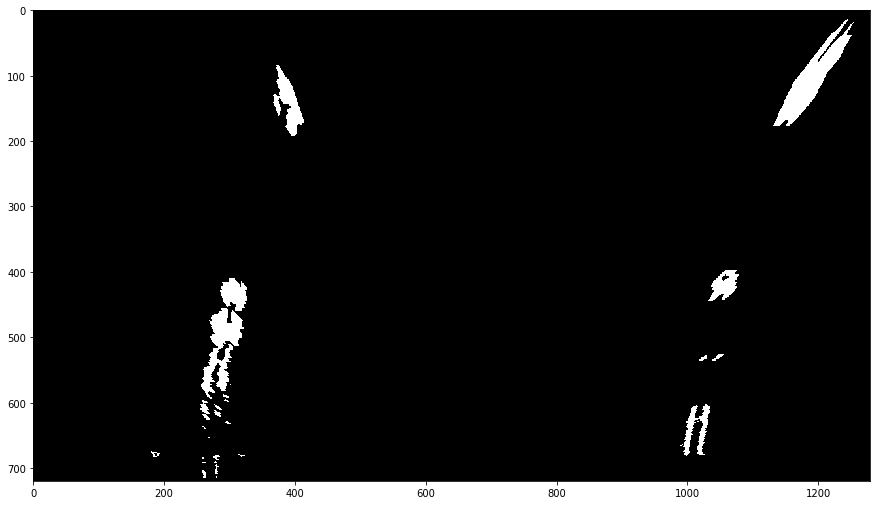

In [9]:
""" Pipeline Step 6: Combine threshold binary images """

def combine_color_gradient_threshold(binary_color, binary_gradient, debug=False):
    """
    Make final binary image by combining color and gradient binary images.
    
    If lanes are not detected, use both color AND gradient binaries for more restrictive 
    selection of lane pixels.  This minimizes misdetection from noise and interference
    by cracks, shadows, etc in the road.
    
    If lanes are already detected, use only color binary for more broad selection since the
    search is already limited to a window around the known lane location.  This allows more
    lane pixels to get a better polyfit and extend the detected lane further down the road.
    
    This function returns the final warped binary image to use for lane detection.
    """
    
    if (left_lane.detected == True) and (right_lane.detected == True):
        binary_final = binary_color
    else:
        binary_final = cv2.bitwise_and(binary_color, binary_gradient)
    
    if debug == True:
        print('Combine color + gradient')
        plt.figure(figsize = (15, 10))
        plt.imshow(binary_final, cmap='gray')
        plt.show()

    return binary_final


binary_final = combine_color_gradient_threshold(binary_color_warped, binary_gradient_warped, debug=True)

Histogram search for lane peaks


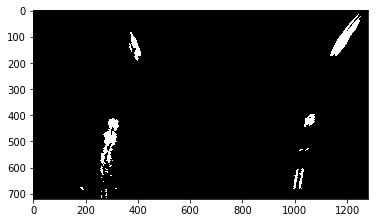

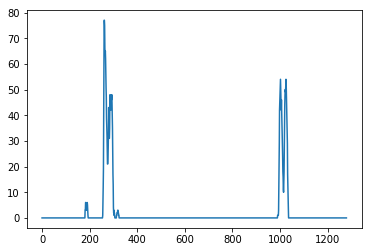

Search by sliding windows


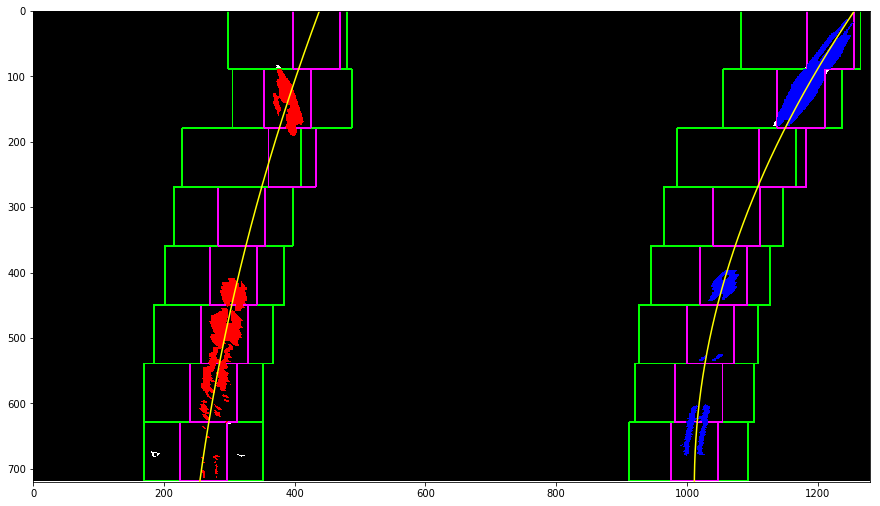

*** Lane validity check ***
min_lane_width: 742.119681487 , max_lane_width: 818.086101064
left_x_num: 8000 , right_x_num: 8046
Left detected: True , Right detected: True
Left validity: OK Right validity: OK

Detected lane area and lane points


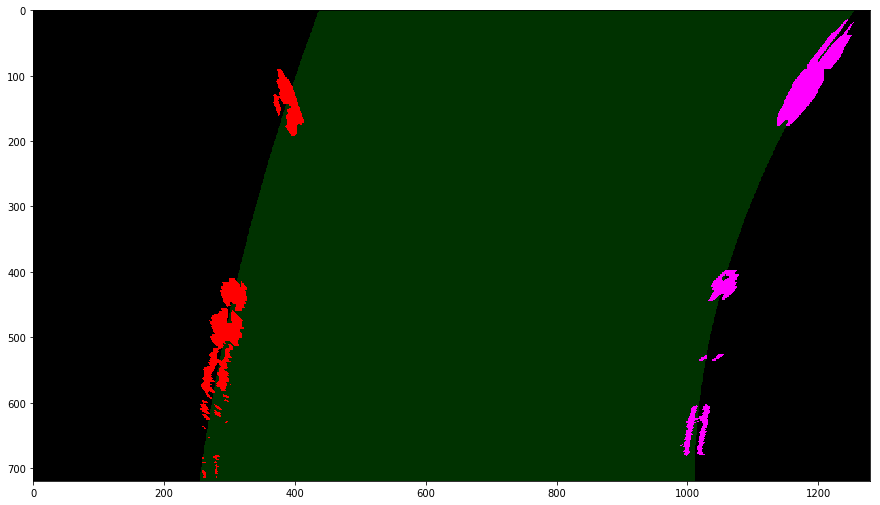

In [10]:
""" Pipeline Step 7: Lane detection and validity judgement """

def search_for_new_lanes(binary_warped, debug=False):
    """
    Search for new lanes in the warped binary image by using sliding windows of 
    width NEW_WINDOW_MARGIN_M and vertically split into N_WINDOWS.
    Start the bottom windows centered at initial x positions found by two max peaks in vertical 
    slice histograms of the bottom 1/4 (or 1/2 if no points were found) of the binary image.
    Use the mean x position of the points within the window to set the center of the next window up.
    If not enough points are found on one side, but the other side has points, set the window center
    based on the previous detected lane width between left/right windows.
    If not enough points are found on either side, continue to slide the window centers by momentum
    calculated by the previous window lateral movements.
    Narrow the window to width NEW_LANE_MARGIN_M to set the final lane x, y points to reduce noise.
    
    This function stores the detected lane x,y values and polyfits in the lane objects:
        left_lane.current_x
        left_lane.current_y
        right_lane.current_x
        right_lane.current_y
        left_lane.current_fit
        right_lane.current_fit
    """
    # Tuning parameters
    N_WINDOWS = 8
    FOUND_MIN_PIX = 50 # pix
    HIST_PEAK_MARGIN_M = 2.2 # (m) minimum separation in detected histogram peaks
    NEW_WINDOW_MARGIN_M = 0.5 # (m) search window width for sliding windows
    NEW_LANE_MARGIN_M = 0.2 # (m) search window width for final point detection
    
    # Initialize
    left_lane_xpts = []
    left_lane_ypts = []
    right_lane_xpts = []
    right_lane_ypts = []
    hist_peak_margin = np.int(HIST_PEAK_MARGIN_M / xm_per_pix)
    window_margin = np.int(NEW_WINDOW_MARGIN_M / xm_per_pix)
    lane_margin = np.int(NEW_LANE_MARGIN_M / xm_per_pix)
    
    # Create an output image to draw sliding windows on
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255

    ### Vertical Sum Histograms ###
    
    # First try taking histogram of bottom 1/4 of image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//4*3:,:], axis=0)
    if np.sum(histogram) == 0:
        # if no pix were found, retake histogram of bottom 1/2 of image
        histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)

    ### Histogram Peak Detection ###
    
    # Look for two peaks in histogram to start searching for left/right lanes
    first_peak_x = np.argmax(histogram)
    look_right_x = min(first_peak_x + hist_peak_margin, binary_warped.shape[1]-1)
    look_left_x = max(first_peak_x - hist_peak_margin, 1)
    right_of_first_peak = max(histogram[look_right_x:])
    left_of_first_peak = max(histogram[:look_left_x])
    if right_of_first_peak > left_of_first_peak:
        # Found second peak to the right of first peak
        win_center_leftx_base = first_peak_x
        win_center_rightx_base = np.argmax(histogram[look_right_x:]) + look_right_x
    else:
        # Found second peak to the left of first peak
        win_center_rightx_base = first_peak_x
        win_center_leftx_base = np.argmax(histogram[:look_left_x])

    # Set height of windows
    win_height = np.int(binary_warped.shape[0]/N_WINDOWS)

    ### Sliding Window Search ###
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Initial values for window momentum
    win_leftx_momentum = 0
    win_rightx_momentum = 0
    win_center_leftx_current = win_center_leftx_base
    win_center_rightx_current = win_center_rightx_base

    # Initial value for detected lane width
    current_lane_width = win_center_rightx_current - win_center_leftx_current

    # Step through the windows one by one
    for n_window in range(N_WINDOWS):
        win_center_leftx_prev = win_center_leftx_current # store for window momentum
        win_center_rightx_prev = win_center_rightx_current

        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (n_window+1)*win_height
        win_y_high = binary_warped.shape[0] - n_window*win_height
        win_xleft_low = win_center_leftx_current - window_margin
        win_xleft_high = win_center_leftx_current + window_margin
        win_xright_low = win_center_rightx_current - window_margin
        win_xright_high = win_center_rightx_current + window_margin

        # Draw the windows on the visualization image
        cv2.rectangle(out_img, (win_xleft_low,win_y_low), (win_xleft_high,win_y_high), (0,255,0), 2) 
        cv2.rectangle(out_img, (win_xright_low,win_y_low), (win_xright_high,win_y_high), (0,255,0), 2) 

        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high)
                        & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high)
                        & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        num_left = len(good_left_inds)
        num_right = len(good_right_inds)

        # Update search window centers
        if (num_left > FOUND_MIN_PIX) and (num_right > FOUND_MIN_PIX):
            # Left OK, Right OK -> set window centers by mean x positions
            win_center_leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            win_center_rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            current_lane_width = win_center_rightx_current - win_center_leftx_current
        elif (num_left < FOUND_MIN_PIX) and (num_right > FOUND_MIN_PIX):
            # Left NG, Right OK -> set Left window center by lane width
            win_center_rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            win_center_leftx_current = win_center_rightx_current - current_lane_width
        elif (num_left > FOUND_MIN_PIX) and (num_right < FOUND_MIN_PIX):
            # Left OK, Right NG -> set Right window center by lane width
            win_center_leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            win_center_rightx_current = win_center_leftx_current + current_lane_width
        elif (num_left < FOUND_MIN_PIX) and (num_right < FOUND_MIN_PIX):
            # Left NG, Right NG -> set Left and Right window centers by momentum
            win_center_leftx_current = win_center_leftx_prev + win_leftx_momentum
            win_center_rightx_current = win_center_rightx_prev + win_rightx_momentum

        # Update window momentum
        win_leftx_momentum = (win_center_leftx_current - win_center_leftx_prev)
        win_rightx_momentum = (win_center_rightx_current - win_center_rightx_prev)

        # Narrow window for actual final x,y point selection
        win_xleft_low = win_center_leftx_current - lane_margin
        win_xleft_high = win_center_leftx_current + lane_margin
        win_xright_low = win_center_rightx_current - lane_margin
        win_xright_high = win_center_rightx_current + lane_margin
        cv2.rectangle(out_img, (win_xleft_low,win_y_low), (win_xleft_high,win_y_high), (255,0,255), 2) 
        cv2.rectangle(out_img, (win_xright_low,win_y_low), (win_xright_high,win_y_high), (255,0,255), 2) 
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high)
                        & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high)
                        & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]

        # Append these x,y values to the lists
        left_lane_xpts.append(nonzerox[good_left_inds])
        left_lane_ypts.append(nonzeroy[good_left_inds])
        right_lane_xpts.append(nonzerox[good_right_inds])
        right_lane_ypts.append(nonzeroy[good_right_inds])

    # After searching all windows, concatenate and store detected x,y points
    left_lane.current_x = np.concatenate(left_lane_xpts)
    left_lane.current_y = np.concatenate(left_lane_ypts)
    right_lane.current_x = np.concatenate(right_lane_xpts)
    right_lane.current_y = np.concatenate(right_lane_ypts)
    
    # Polyfit detected points
    if (len(left_lane.current_x) > 0) and (len(left_lane.current_x) == len(left_lane.current_y)):
        left_lane.current_fit = np.polyfit(left_lane.current_y, left_lane.current_x, 2)
    if (len(right_lane.current_x) > 0) and (len(right_lane.current_x) == len(right_lane.current_y)):
        right_lane.current_fit = np.polyfit(right_lane.current_y, right_lane.current_x, 2)
    
    if debug == True:
        print('Histogram search for lane peaks')
        plt.imshow(binary_warped, cmap='gray')
        plt.show()        
        plt.plot(histogram)
        plt.show()

        print('Search by sliding windows')
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
        left_fitx = (left_lane.current_fit[0]*ploty**2 + left_lane.current_fit[1]*ploty + left_lane.current_fit[2])
        right_fitx = (right_lane.current_fit[0]*ploty**2 + right_lane.current_fit[1]*ploty + right_lane.current_fit[2])
        out_img[left_lane.current_y, left_lane.current_x] = [255, 0, 0]
        out_img[right_lane.current_y, right_lane.current_x] = [0, 0, 255]
        plt.figure(figsize = (15, 10))
        plt.imshow(out_img)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        plt.show()
    
def search_for_existing_lanes(binary_warped, debug=False):
    """
    Search for lanes around existing detected lane line polyfits with margin DETECTED_LANE_WINDOW_MARGIN.
    
    This function stores the detected lane x,y values and polyfits in the lane objects:
        left_lane.current_x
        left_lane.current_y
        right_lane.current_x
        right_lane.current_y
        left_lane.current_fit
        right_lane.current_fit
    """
    # Tuning parameters
    DETECTED_LANE_WINDOW_MARGIN = 0.3 # (m)
    
    # Get current lane fits
    left_fit = left_lane.current_fit
    right_fit = right_lane.current_fit
    margin = np.int(DETECTED_LANE_WINDOW_MARGIN / xm_per_pix)

    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) 
                    & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) 
                     & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    left_lane.current_x = nonzerox[left_lane_inds]
    left_lane.current_y = nonzeroy[left_lane_inds] 
    right_lane.current_x = nonzerox[right_lane_inds]
    right_lane.current_y = nonzeroy[right_lane_inds]

    # Polyfit detected points
    if (len(left_lane.current_x) > 0) and (len(left_lane.current_x) == len(left_lane.current_y)):
        left_lane.current_fit = np.polyfit(left_lane.current_y, left_lane.current_x, 2)
    if (len(right_lane.current_x) > 0) and (len(right_lane.current_x) == len(right_lane.current_y)):
        right_lane.current_fit = np.polyfit(right_lane.current_y, right_lane.current_x, 2) 

    if debug == True:
        # Make images for plotting
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
        window_img = np.zeros_like(out_img)
        
        # Plot current lane fit curves
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
        left_fitx = (left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2])
        right_fitx = (right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2])
        
        # Color in left and right line pixels
        out_img[left_lane.current_y, left_lane.current_x] = [255, 0, 0]
        out_img[right_lane.current_y, right_lane.current_x] = [0, 0, 255]
        
        # Generate a polygon to illustrate the search window area around the lane fit curves
        # and recast the x and y points into usable format for cv2.fillPoly()
        left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
        left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
        left_line_pts = np.hstack((left_line_window1, left_line_window2))
        right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
        right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
        right_line_pts = np.hstack((right_line_window1, right_line_window2))
        cv2.fillPoly(window_img, np.int_([left_line_pts]), (0, 255, 0))
        cv2.fillPoly(window_img, np.int_([right_line_pts]), (0, 255, 0))
        
        # Combine lane fit curves, lane points, and search window area
        result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

        print('Search by current lane fit curves')
        plt.figure(figsize = (15, 10))
        plt.imshow(result)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.show()

def lane_validity_check(binary_warped, debug=False):
    """
    Judge if detected lane is valid based on min/max lane width and number of detected lane line pixels.
    
    This function stores the lane detection judgement flag in the lane objects:
        left_lane.detected
        right_lane.detected
    """
    # Tuning parameters
    LANE_DETECT_MIN_PIX = 50 # pix
    LANE_DETECT_MAX_PIX = 70000 # pix
    LANE_WIDTH_MIN_M = 1.0 # m
    LANE_WIDTH_MAX_M = 6.0 # m

    # Initialize
    left_lane.valid_reason = 'OK'
    right_lane.valid_reason = 'OK'
    left_ok = True
    right_ok = True
    min_lane_width = 0
    max_lane_width = 0
    left_fit = left_lane.current_fit
    right_fit = right_lane.current_fit
    left_x_num = len(left_lane.current_x)
    left_y_num = len(left_lane.current_y)
    right_x_num = len(right_lane.current_x)
    right_y_num = len(right_lane.current_y)
    lane_width_min_pix = np.int(LANE_WIDTH_MIN_M / xm_per_pix)
    lane_width_max_pix = np.int(LANE_WIDTH_MAX_M / xm_per_pix)

    # Calculate max/min lane widths
    y_eval = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    leftx_eval = left_fit[0]*y_eval**2 + left_fit[1]*y_eval + left_fit[2]
    rightx_eval = right_fit[0]*y_eval**2 + right_fit[1]*y_eval + right_fit[2]
    min_lane_width = min(rightx_eval - leftx_eval)
    max_lane_width = max(rightx_eval - leftx_eval)
    
    # Judge if lanes are reasonable by lane width
    if min_lane_width < lane_width_min_pix:
        left_ok = False
        right_ok = False
        left_lane.valid_reason = 'Lane too narrow'
        right_lane.valid_reason = left_lane.valid_reason

    if max_lane_width > lane_width_max_pix:
        left_ok = False
        right_ok = False
        left_lane.valid_reason = 'Lane too wide'
        right_lane.valid_reason = left_lane.valid_reason
     
    # Judge if lanes are reasonable by number of detected pixels
    if ((left_x_num != left_y_num)
        or (left_x_num < LANE_DETECT_MIN_PIX) 
        or (left_x_num > LANE_DETECT_MAX_PIX)):
        left_ok = False
        right_ok = False
        left_lane.valid_reason = 'Number of Lane Pixels'
        
    if ((right_x_num != right_y_num)
        or (right_x_num < LANE_DETECT_MIN_PIX)
        or (right_x_num > LANE_DETECT_MAX_PIX)):
        left_ok = False
        right_ok = False
        right_lane.valid_reason = 'Number of Lane Pixels'

    # Store result in lane objects
    left_lane.detected = left_ok
    right_lane.detected = right_ok
    
    if debug == True:
        print('*** Lane validity check ***')
        print('min_lane_width:', min_lane_width, ', max_lane_width:', max_lane_width)
        print('left_x_num:', left_x_num, ', right_x_num:', right_x_num)
        print('Left detected:', left_ok, ', Right detected:', right_ok)
        print('Left validity:', left_lane.valid_reason, 'Right validity:', right_lane.valid_reason)
        print('')

def update_lane_pts_and_polyfit():
    """
    If both lane lines are judged valid, combine the lane x,y values into an array of length N_FITS.
    Polyfit lane lines based on the combined x,y values to represent the smoothed average lane area.
    If either lane lines are invalid, do not update the combined arrays and polyfits.
    
    This function stores the combined lane x,y values and polyfits in the lane objects:
        left_lane.all_x
        left_lane.all_y
        right_lane.all_x
        right_lane.all_y
        left_lane.all_fit
        right_lane.all_fit
    """
    if left_lane.detected == True and right_lane.detected == True:
        # Append current x,y points to combined lane points
        while len(left_lane.all_x) >= left_lane.N_FITS:
            left_lane.all_x.pop(0)
            left_lane.all_y.pop(0)
        while len(right_lane.all_x) >= right_lane.N_FITS:
            right_lane.all_x.pop(0)
            right_lane.all_y.pop(0)

        left_lane.all_x.append(left_lane.current_x)
        left_lane.all_y.append(left_lane.current_y)
        right_lane.all_x.append(right_lane.current_x)
        right_lane.all_y.append(right_lane.current_y)

        # Rebuild combined x,y points for polyfit
        left_lane_xpts = np.concatenate(left_lane.all_x)
        left_lane_ypts = np.concatenate(left_lane.all_y)
        right_lane_xpts = np.concatenate(right_lane.all_x)
        right_lane_ypts = np.concatenate(right_lane.all_y)

        # Fit to full combined array of points
        left_lane.all_fit = np.polyfit(left_lane_ypts, left_lane_xpts, 2)
        right_lane.all_fit = np.polyfit(right_lane_ypts, right_lane_xpts, 2) 

def make_lane_area_image(binary_warped, debug=False):
    """
    Generate an RGB image of the detected lane lines and points to use for overlaying with the
    original road image.  The output image is the warped bird's eye view which needs to be
    transformed back to the original road perspective.
    
    The lane area is made from the smoothed average polyfits:
        left_lane.all_fit
        right_lane.all_fit
        
    The lane points are from the current frame's detected points:
        left_lane.current_x
        left_lane.current_y
        right_lane.current_x
        right_lane.current_y        
    
    This function returns the warped RGB image of the detected lane lines and points.
    """
    # Get lane parameters
    left_fit = left_lane.all_fit
    right_fit = right_lane.all_fit
    left_x = left_lane.current_x
    left_y = left_lane.current_y
    right_x = right_lane.current_x
    right_y = right_lane.current_y

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Create a blank image to draw on
    img_lane_area = np.dstack((binary_warped, binary_warped, binary_warped))*0

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane area and lane points onto the warped blank image
    if left_lane.detected == True and right_lane.detected == True:
        lane_area_color = (0, 50, 0)
    else:
        lane_area_color = (50, 0, 0)
    cv2.fillPoly(img_lane_area, np.int_([pts]), lane_area_color)
    img_lane_area[left_y, left_x] = [255, 0, 0]
    img_lane_area[right_y, right_x] = [255, 0, 255]
        
    if debug == True:
        print('Detected lane area and lane points')
        plt.figure(figsize = (15, 10))
        plt.imshow(img_lane_area)
        plt.show()
        
    return img_lane_area

    
if (left_lane.detected == False) or (right_lane.detected == False):
    search_for_new_lanes(binary_final, debug=True)
else:
    search_for_existing_lanes(binary_final, debug=True)
lane_validity_check(binary_final, debug=True)
update_lane_pts_and_polyfit()
img_lane_lines = make_lane_area_image(binary_final, debug=True)

In [11]:
""" Pipeline Step 8: Radius of curvature and offset from lane center calculation """

def calc_radius_and_offset(img, debug):
    """
    Calculate radius of curvatures for the 2nd degree polyfits at the bottom point based on the equation
        x = A*y^2 + B*y + C
        R_curve = (1+(2*A*y+B)^2)^(3/2) / |2*A|
    
    Calculate the offset lateral distance from the car to each lane line by assuming the car is at the
    midpoint of the image.
    
    This function stores the calculated radius of curvature and offset distances into the lane objects:
        left_lane.radius_of_curvature
        right_lane.radius_of_curvature
        left_lane.line_base_pos
        right_lane.line_base_pos
    """
    # Get lane point pixels
    leftx = np.concatenate(left_lane.all_x)
    lefty = np.concatenate(left_lane.all_y)
    rightx = np.concatenate(right_lane.all_x)
    righty = np.concatenate(right_lane.all_y)
    y_eval = img.shape[0] # bottom y val
    
    if (len(leftx) > 0) and (len(rightx) > 0):
        # Fit new polynomials to x,y in world space
        left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
        right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)

        # Calculate the new radii of curvature
        left_curverad = (((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5)
                          / np.absolute(2*left_fit_cr[0]))
        right_curverad = (((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5)
                          / np.absolute(2*right_fit_cr[0]))

        left_lane.radius_of_curvature = left_curverad
        right_lane.radius_of_curvature = right_curverad

        # Calculate lane offset positions
        p_left = np.poly1d(left_fit_cr)
        p_right = np.poly1d(right_fit_cr)
        x_midpoint = np.int(img.shape[1]/2)*xm_per_pix

        left_lane.line_base_pos = x_midpoint - p_left(y_eval*ym_per_pix)
        right_lane.line_base_pos = p_right(y_eval*ym_per_pix) - x_midpoint
        
        if debug == True:
            print('Left radius:', left_lane.radius_of_curvature,
                  'm, Right radius:', right_lane.radius_of_curvature, 'm')
            print('Offset:', right_lane.line_base_pos-left_lane.line_base_pos, 'm')

            
calc_radius_and_offset(img_lane_lines, debug=True)

Left radius: 731.453730326 m, Right radius: 256.857503562 m
Offset: -0.0756781154395 m


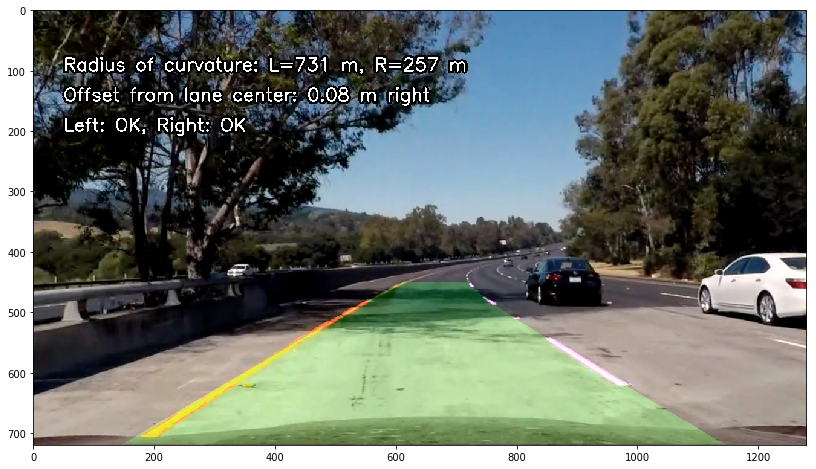

In [12]:
""" Pipeline Step 9: Overlay detected lane and text info back to road image """

def overlay_lane_area(img_undist, img_lane_lines, Minv, debug=False):
    """
    Overlay the detected lane area image with the original road image after undistortion using the
    inverse perspective transform matrix Minv.
    
    This function returns the overlaid image of detected lane area and points on the original road
    with text showing the radius of curvature, offset from lane center, and lane validity result.
    """
    def overlay_text(image, text, pos):
        cv2.putText(image, text, pos, fontFace=cv2.FONT_HERSHEY_SIMPLEX,
                    fontScale=1, color=(0,0,0), thickness=10)
        cv2.putText(image, text, pos, fontFace=cv2.FONT_HERSHEY_SIMPLEX,
                    fontScale=1, color=(255,255,255), thickness=2)
        
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(img_lane_lines, Minv, (img_lane_lines.shape[1], img_lane_lines.shape[0])) 
    overlaid_result = cv2.addWeighted(img_undist, 1, newwarp, 1, 0)
    
    # Overlay text information
    left_curverad = left_lane.radius_of_curvature
    right_curverad = right_lane.radius_of_curvature
    lane_offset = right_lane.line_base_pos - left_lane.line_base_pos
    if lane_offset < 0:
        side = 'right'
    else:
        side = 'left'
    overlay_text(overlaid_result, 'Radius of curvature: L={:.0f} m, R={:.0f} m'
                                  .format(left_curverad, right_curverad), (50,100))
    overlay_text(overlaid_result, 'Offset from lane center: {:.2f} m {}'
                                  .format(abs(lane_offset), side), (50,150))
    overlay_text(overlaid_result, 'Left: {}, Right: {}'
                                  .format(left_lane.valid_reason, right_lane.valid_reason), (50,200))
    
    if debug == True:
        plt.figure(figsize = (15,8))
        plt.imshow(overlaid_result)
        plt.show()
    
    return overlaid_result


overlaid_result = overlay_lane_area(img_undist, img_lane_lines, Minv, debug=True)

## Run Pipeline

In [13]:
def my_lane_pipeline(img, debug=False):
    
    """ Pipeline Step 1: Undistort image with camera calibration coefficients """
    img_undist = camera_undistort(img, mtx, dist, debug=False)
    
    """ Pipeline Step 2: Adaptive histogram equalization for lightness of image """
    img_CLAHE = apply_CLAHE_LAB(img_undist, debug=False)
    
    """ Pipeline Step 3: Perspective transform to bird's eye view """
    M, Minv = set_perspective_transform(img_undist, video=VIDEO_SWITCH, debug=False)
    img_warped = do_perspective_transform(img_undist, M, debug=False)
    
    """ Pipeline Step 4: Color threshold binary image """
    binary_color = color_binary_thresh(img_CLAHE, debug=False)
    binary_color_warped = do_perspective_transform(binary_color, M, debug=False)

    """ Pipeline Step 5: Gradient threshold binary image """
    if (left_lane.detected == False) or (right_lane.detected == False):
        binary_gradx_warped = sobel_x_thresh(img_warped, thresh=(10, 255), debug=False)
        binary_gradx_warped = sobel_denoise(binary_gradx_warped, kernel=5, thresh=0.7, debug=False)
        binary_mag = sobel_mag_thresh(img_undist, sobel_kernel=3, thresh=(5, 255), debug=False)
        binary_dir = sobel_dir_thresh(img_undist, sobel_kernel=3, thresh=(0.5, 1.3), debug=False)
        binary_magdir = sobel_magdir_combine(binary_mag, binary_dir, debug=False)
        binary_magdir = sobel_denoise(binary_magdir, kernel=5, thresh=0.7, debug=False)
        binary_magdir_warped = do_perspective_transform(binary_magdir, M, debug=False)
        binary_gradient_warped = grad_combo_binary_thresh(binary_gradx_warped, binary_magdir_warped, debug=False)
    else:
        binary_gradient_warped = None

    """ Pipeline Step 6: Combine threshold binary images """
    binary_final = combine_color_gradient_threshold(binary_color_warped, binary_gradient_warped, debug=False)
    
    """ Pipeline Step 7: Lane detection and validity judgement """
    if (left_lane.detected == False) or (right_lane.detected == False):
        search_for_new_lanes(binary_final, debug=False)
    else:
        search_for_existing_lanes(binary_final, debug=False)
        
    lane_validity_check(binary_final, debug=False)
    update_lane_pts_and_polyfit()
    img_lane_lines = make_lane_area_image(binary_final, debug=False)

    """ Pipeline Step 8: Radius of curvature and offset from lane center calculation """
    calc_radius_and_offset(img_lane_lines, debug=False)
    
    """ Pipeline Step 9: Overlay detected lane and text info back to road image """
    overlaid_result = overlay_lane_area(img_undist, img_lane_lines, Minv, debug)
    
    return overlaid_result

Test Images:

 test_images/straight_lines1.jpg without detected lanes


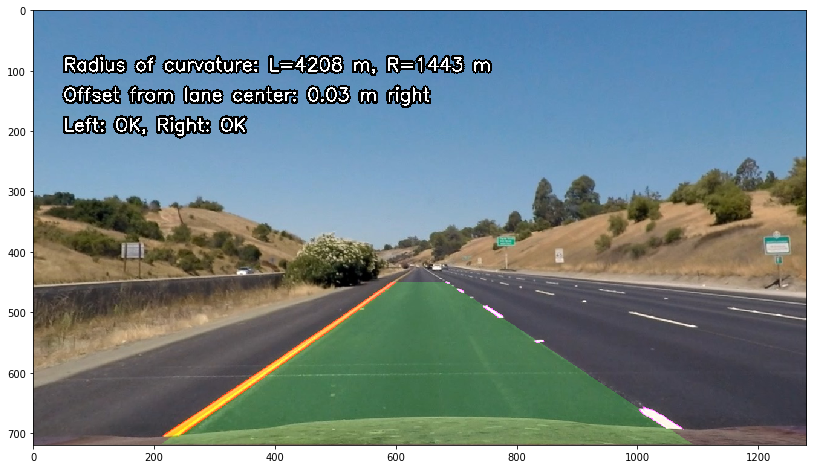


 test_images/straight_lines1.jpg with detected lanes


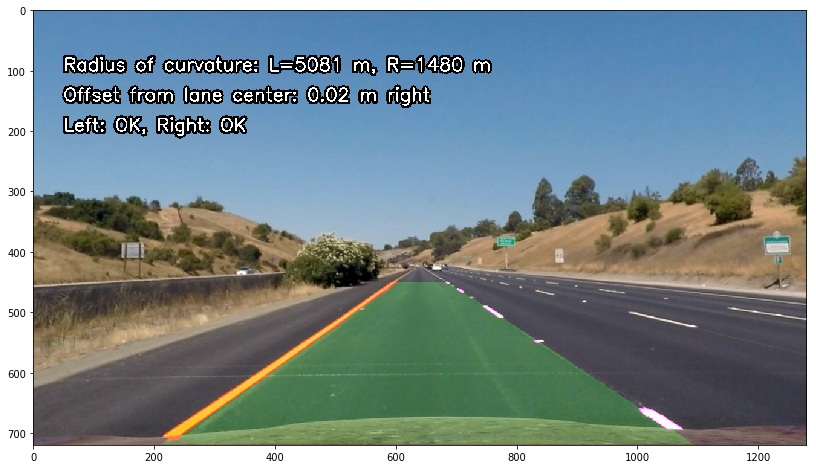



 test_images/straight_lines2.jpg without detected lanes


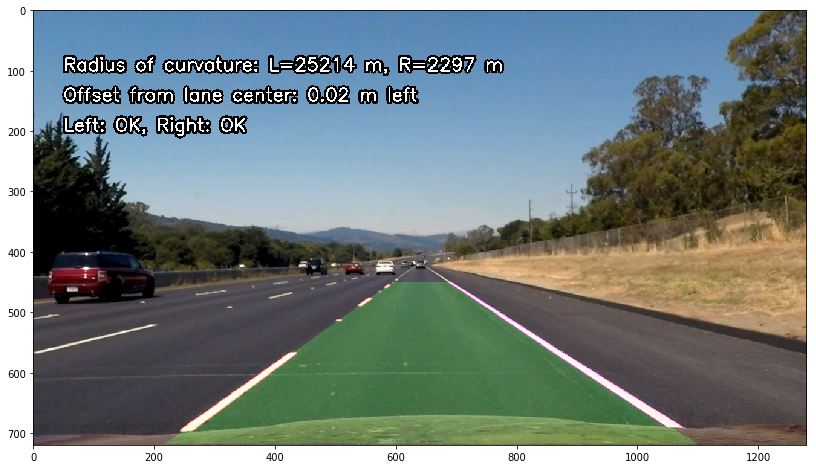


 test_images/straight_lines2.jpg with detected lanes


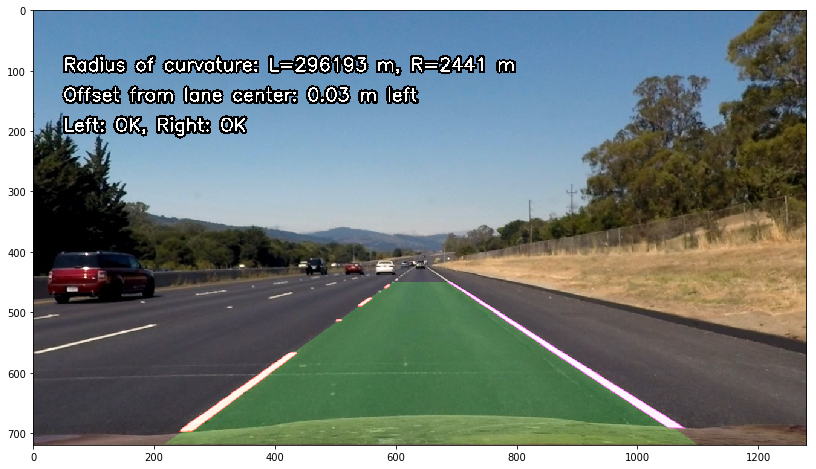



 test_images/test1.jpg without detected lanes


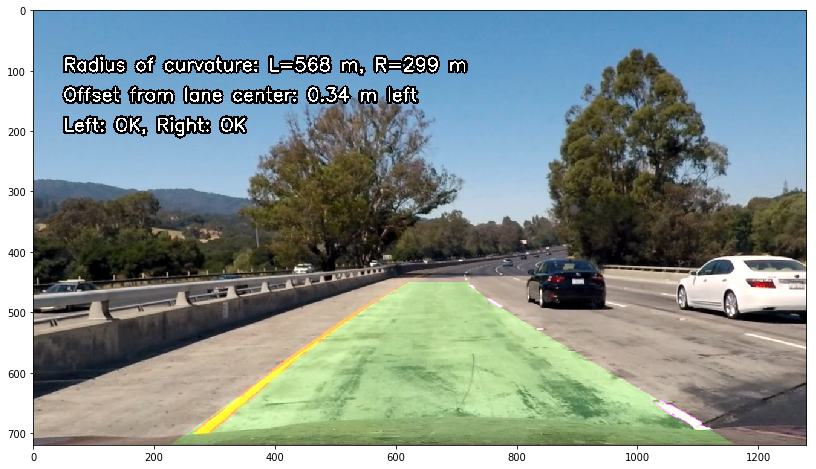


 test_images/test1.jpg with detected lanes


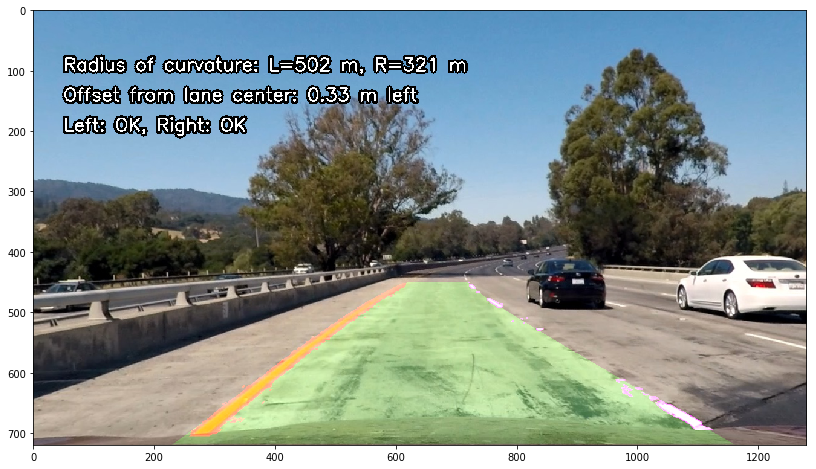



 test_images/test2.jpg without detected lanes


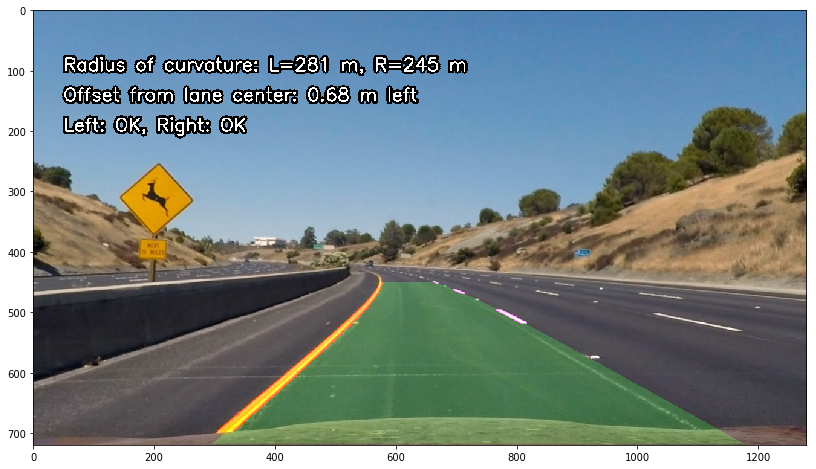


 test_images/test2.jpg with detected lanes


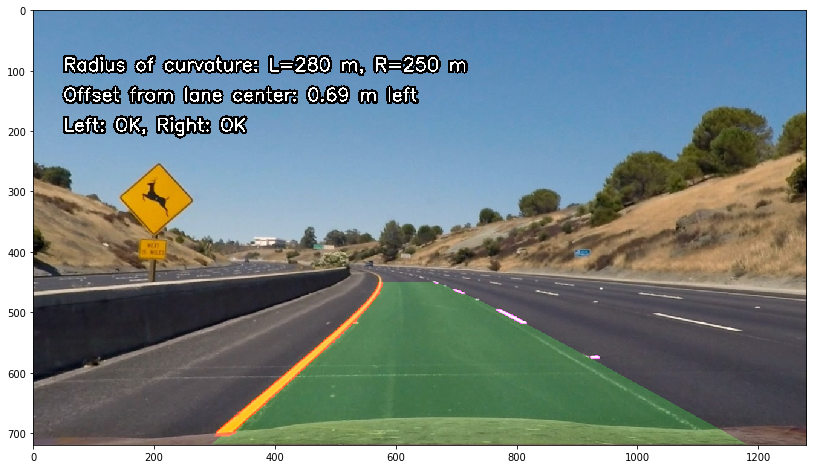



 test_images/test3.jpg without detected lanes


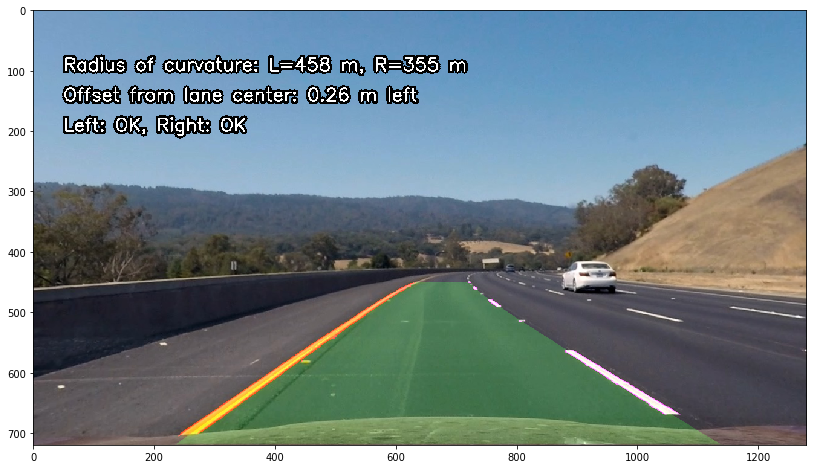


 test_images/test3.jpg with detected lanes


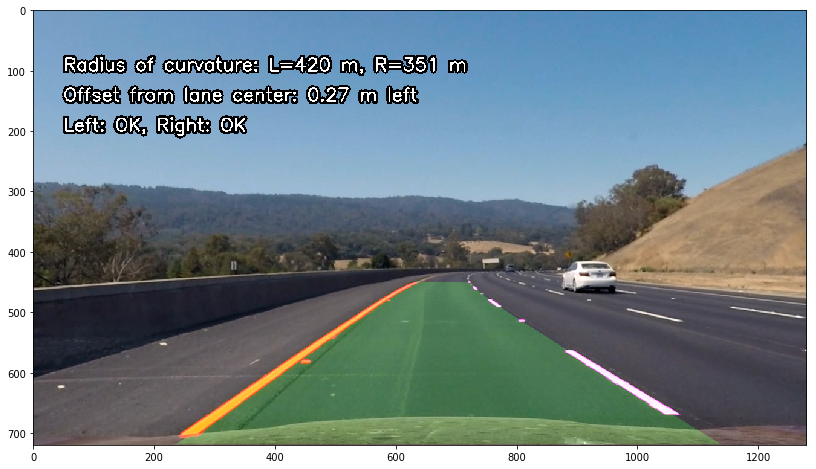



 test_images/test4.jpg without detected lanes


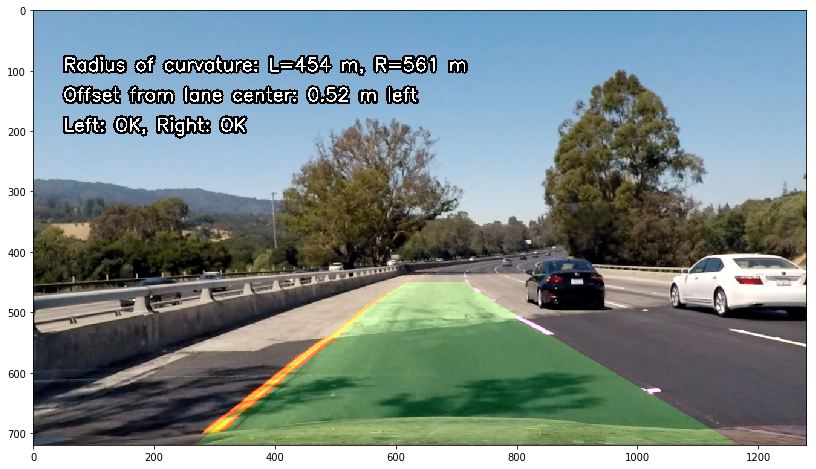


 test_images/test4.jpg with detected lanes


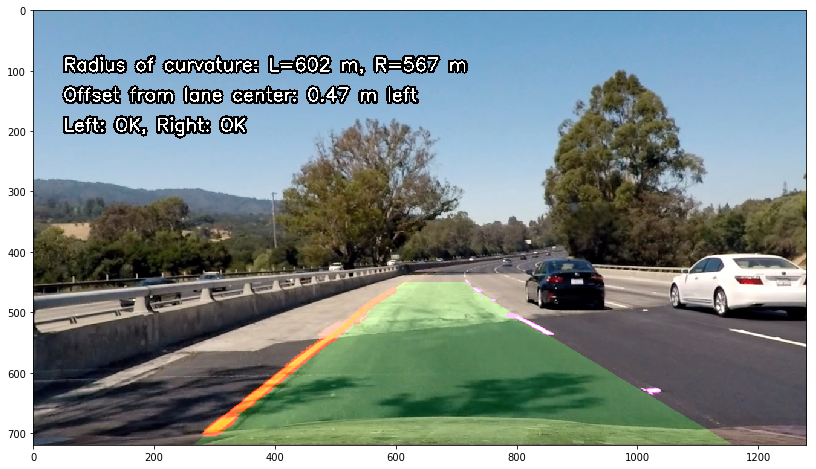



 test_images/test5.jpg without detected lanes


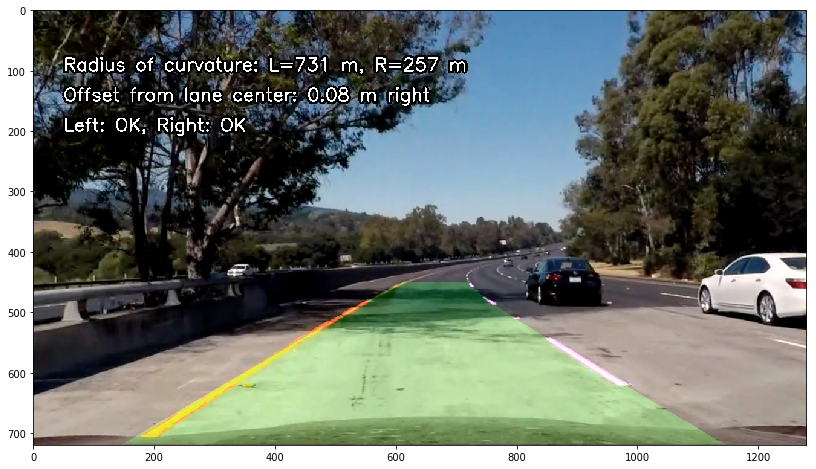


 test_images/test5.jpg with detected lanes


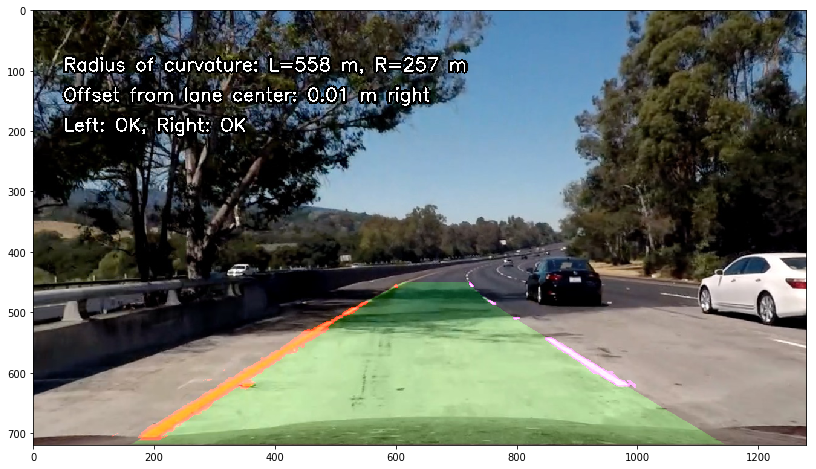



 test_images/test6.jpg without detected lanes


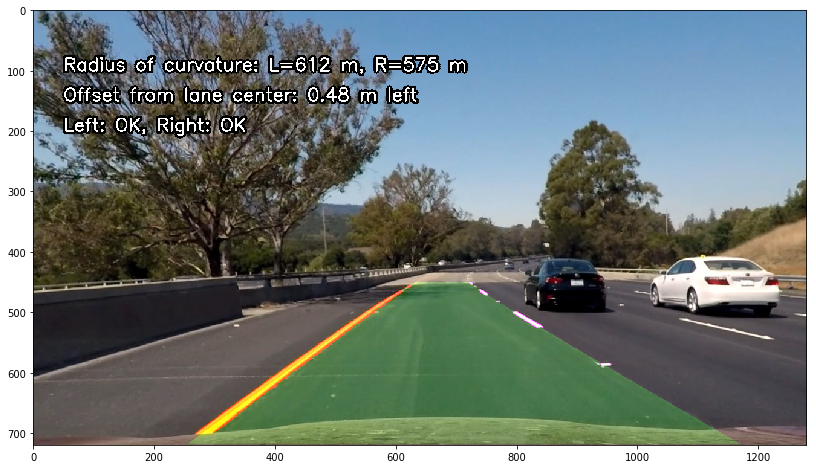


 test_images/test6.jpg with detected lanes


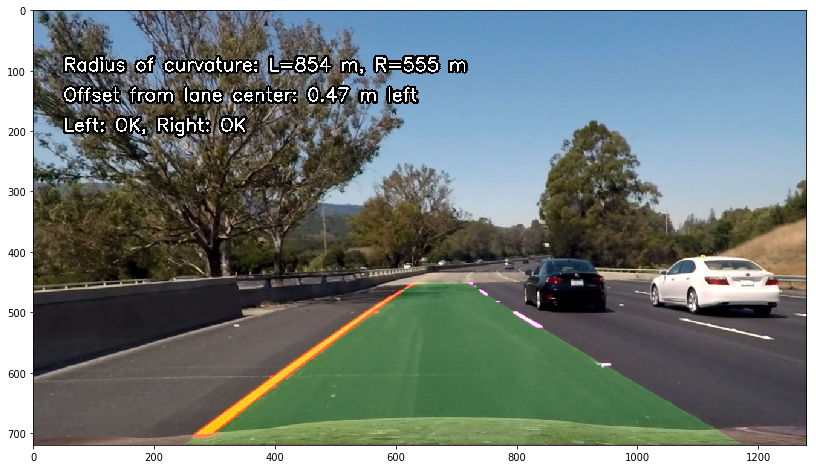


Challenge Images:

 test_images/test_challenge1.jpg without detected lanes


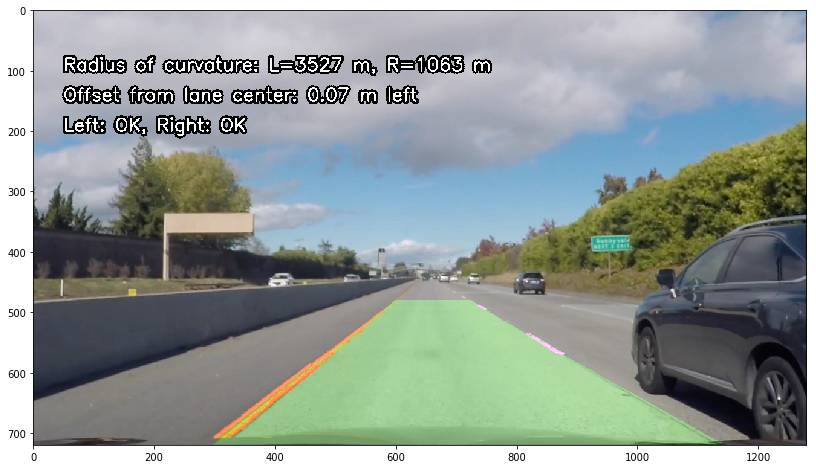


 test_images/test_challenge1.jpg with detected lanes


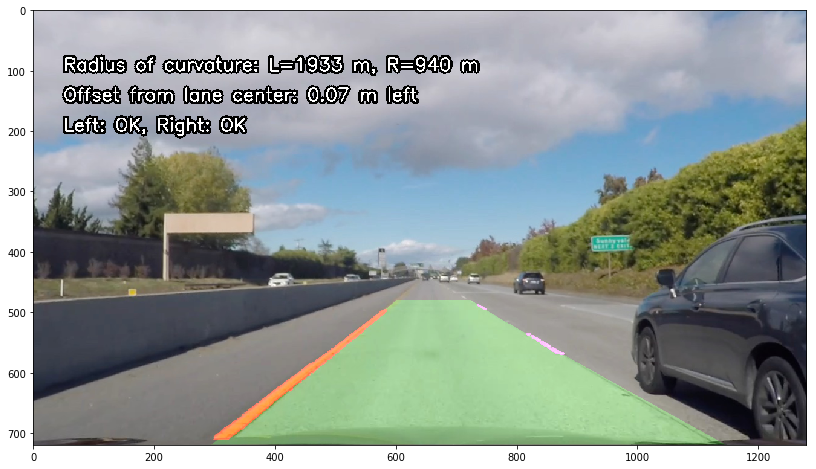



 test_images/test_challenge2.jpg without detected lanes


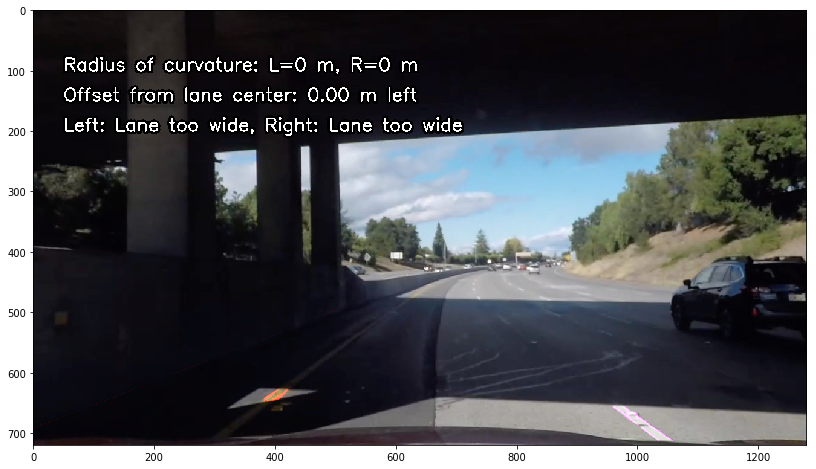


 test_images/test_challenge2.jpg with detected lanes


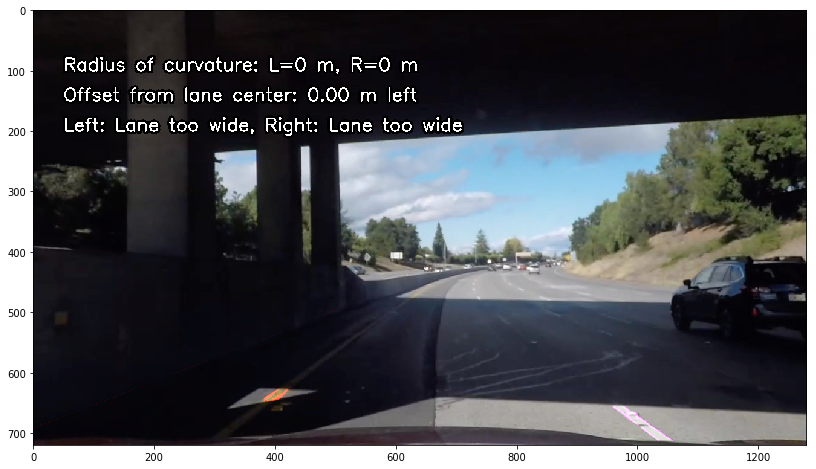



 test_images/test_challenge3.jpg without detected lanes


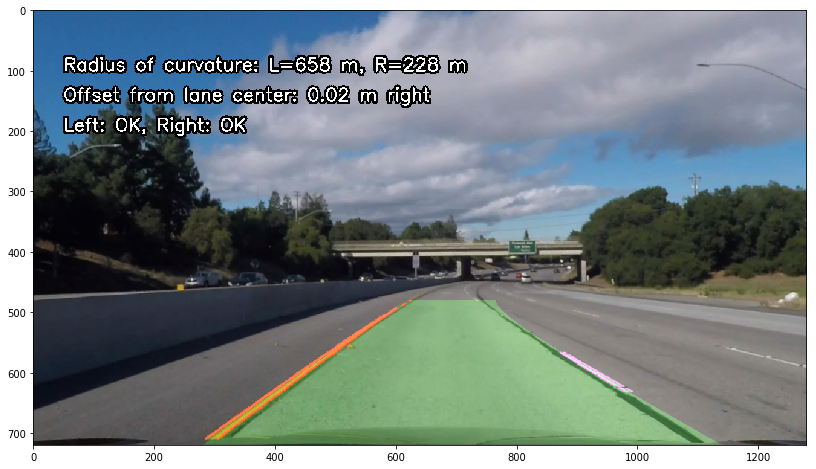


 test_images/test_challenge3.jpg with detected lanes


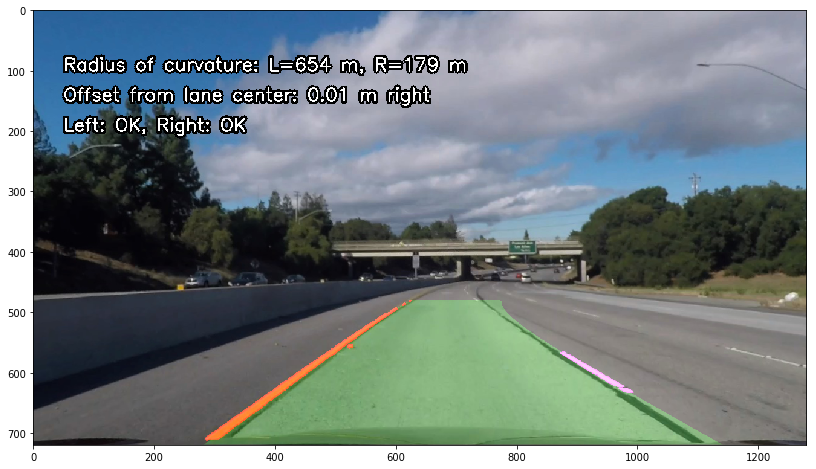


Harder Challenge Images:

 test_images/test_harderchallenge1.jpg without detected lanes


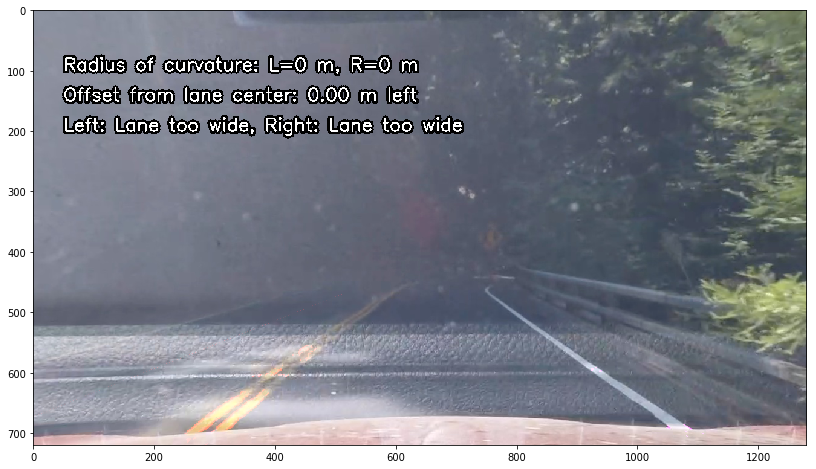


 test_images/test_harderchallenge1.jpg with detected lanes


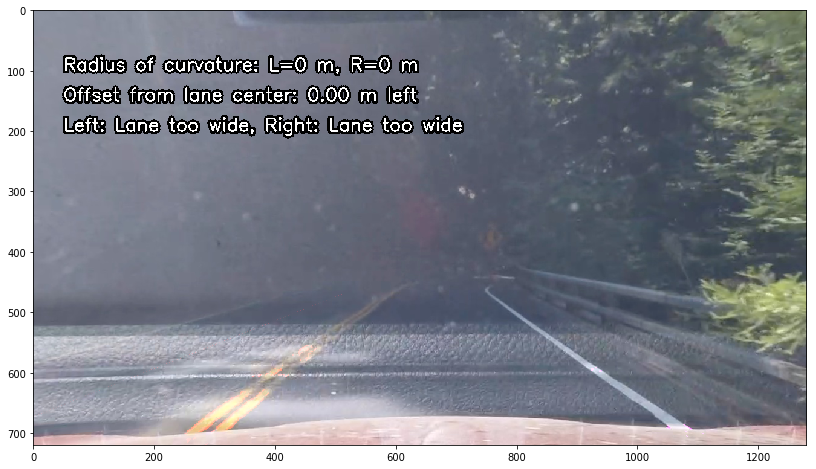



 test_images/test_harderchallenge2.jpg without detected lanes


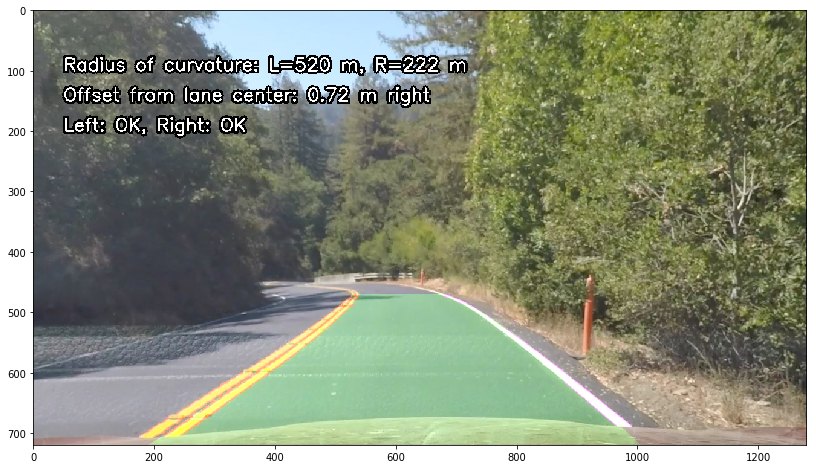


 test_images/test_harderchallenge2.jpg with detected lanes


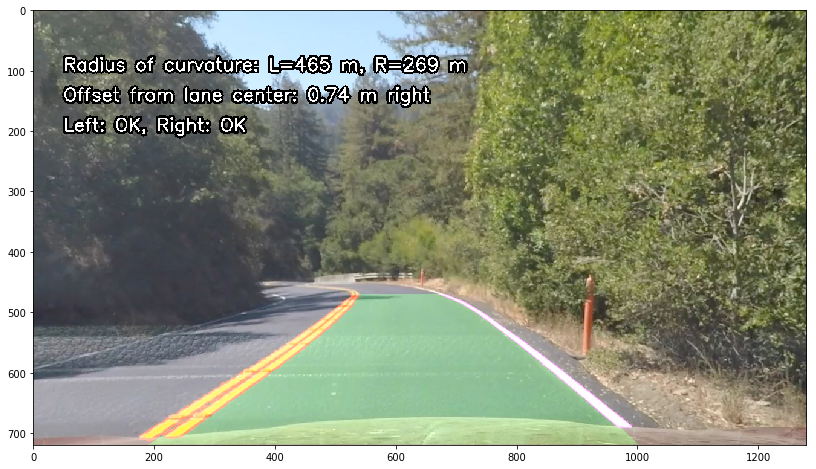


Done.


In [14]:
OUTPUT_ALLTESTS = 1

if OUTPUT_ALLTESTS == 1:
    """
    Run each test image through pipeline two times, the first time being without lanes detected
    and the second time after lanes were detected.
    """
    
    def run_pipeline(img_path):
        reset_lanes()
        print('\n', img_path, 'without detected lanes')
        my_lane_pipeline(mpimg.imread(img_path), debug=True)
        print('\n', img_path, 'with detected lanes')
        my_lane_pipeline(mpimg.imread(img_path), debug=True)
        print('\n============================================================================================')

    print('Test Images:')
    VIDEO_SWITCH = 0 # 0 = Project video
    run_pipeline('test_images/straight_lines1.jpg')
    run_pipeline('test_images/straight_lines2.jpg')
    run_pipeline('test_images/test1.jpg')
    run_pipeline('test_images/test2.jpg')
    run_pipeline('test_images/test3.jpg')
    run_pipeline('test_images/test4.jpg')
    run_pipeline('test_images/test5.jpg')
    run_pipeline('test_images/test6.jpg')
    
    print('Challenge Images:')
    VIDEO_SWITCH = 1 # 1 = Challenge video
    run_pipeline('test_images/test_challenge1.jpg')
    run_pipeline('test_images/test_challenge2.jpg')
    run_pipeline('test_images/test_challenge3.jpg')

    print('Harder Challenge Images:')
    VIDEO_SWITCH = 2 # 2 = Harder challenge video
    run_pipeline('test_images/test_harderchallenge1.jpg')
    run_pipeline('test_images/test_harderchallenge2.jpg')
    
print('Done.')

In [15]:
OUTPUT_VIDEO1 = 1

if OUTPUT_VIDEO1 == 1:
    VIDEO_SWITCH = 0 # 0 = Project video
    reset_lanes()
    clip1_output = 'output_images/project_video.mp4'
    clip1 = VideoFileClip('project_video.mp4')#.subclip(37,43)
    clip1_out = clip1.fl_image(my_lane_pipeline)
    clip1_out.write_videofile(clip1_output, audio=False)

[MoviePy] >>>> Building video output_images/project_video.mp4
[MoviePy] Writing video output_images/project_video.mp4


100%|█████████▉| 1260/1261 [04:55<00:00,  4.16it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_images/project_video.mp4 



In [16]:
OUTPUT_VIDEO2 = 1

if OUTPUT_VIDEO2 == 1:
    VIDEO_SWITCH = 1 # 1 = Challenge video
    reset_lanes()
    clip2_output = 'output_images/challenge_video.mp4'
    clip2 = VideoFileClip('challenge_video.mp4')#.subclip(0,7)
    clip2_out = clip2.fl_image(my_lane_pipeline)
    clip2_out.write_videofile(clip2_output, audio=False)

[MoviePy] >>>> Building video output_images/challenge_video.mp4
[MoviePy] Writing video output_images/challenge_video.mp4


100%|██████████| 485/485 [01:28<00:00,  5.34it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_images/challenge_video.mp4 



In [17]:
OUTPUT_VIDEO3 = 1

if OUTPUT_VIDEO3 == 1:
    VIDEO_SWITCH = 2 # 2 = Harder challenge video
    reset_lanes()
    clip3_output = 'output_images/harder_challenge_video.mp4'
    clip3 = VideoFileClip('harder_challenge_video.mp4')#.subclip(5,10)
    clip3_out = clip3.fl_image(my_lane_pipeline)
    clip3_out.write_videofile(clip3_output, audio=False)

[MoviePy] >>>> Building video output_images/harder_challenge_video.mp4
[MoviePy] Writing video output_images/harder_challenge_video.mp4


100%|█████████▉| 1199/1200 [05:36<00:00,  4.04it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_images/harder_challenge_video.mp4 

